In [2]:
import dtw
import scanpy as sc
import numpy as np
import scanpy.external as sce
import pandas as pd
import scvelo as scv
import seaborn as sns
import matplotlib.pyplot as plt
import importlib
import sys
import symphonypy as sp
import palantir
import scFates as scf

%matplotlib inline

sys.path.append("/home/sergey/tools/sclitr/")
import sclitr as sl

# Pathes
DATA_PATH = "/home/sergey/data/clonal_project"
HOME_PATH = "/home/sergey/projects/clonal_project"

# Additional functions
exec(open(f"{HOME_PATH}/tools/tools.py").read())

sys.path.append("/home/sergey/tools/mmbench/")
import mmbench as mb

import warnings
warnings.filterwarnings("ignore")

import matplotlib

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

sc.set_figure_params(dpi=150, dpi_save=300)
sns.set_style("ticks")

from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats import spearmanr, pearsonr
from tqdm import tqdm

In [3]:
adata_trunk = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_E13_clonal_clusters.h5ad")
adata_face = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_E13_clonal_clusters.h5ad")
adata_clones = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding.h5ad")

In [37]:
l0_palette = {
    "Mesenchyme": "#ca0020",
    "Neurons and glia": "#0571b0",
    "Neurons": "#0571b0",
    "Glia": "#92c5de",
    "Other": "#f4a582",
}

adata_face.uns["celltype_l0_colors"] = [l0_palette[cat] for cat in adata_face.obs.celltype_l0.cat.categories]
adata_trunk.uns["celltype_l0_colors"] = [l0_palette[cat] for cat in adata_trunk.obs.celltype_l0.cat.categories]

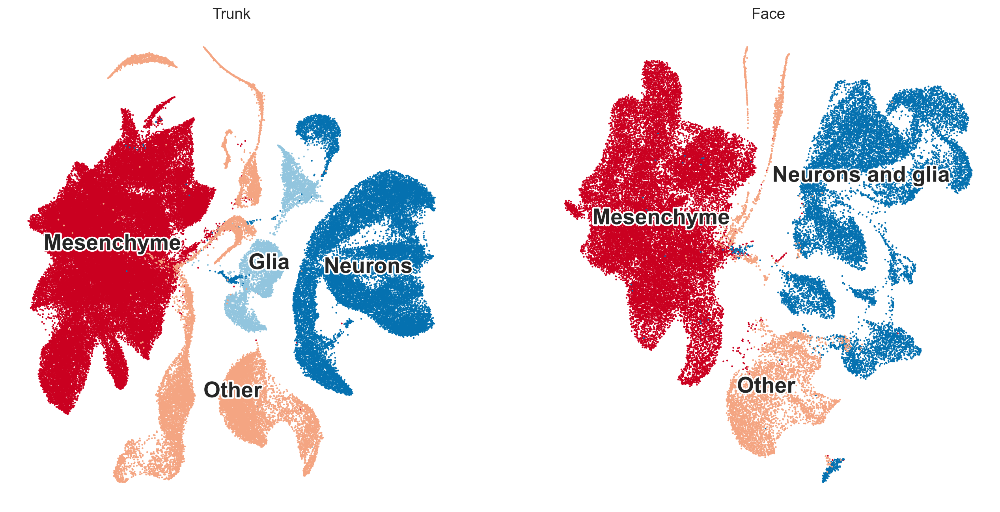

In [79]:
fig, axes = plt.subplots(ncols=2, figsize=(16, 8), dpi=100)

sc.pl.umap(adata_trunk, color="celltype_l0", frameon=False, title="Trunk", ax=axes[0], show=False, s=10,
           legend_loc="on data", legend_fontsize=20, legend_fontoutline=3)
sc.pl.umap(adata_face, color="celltype_l0", frameon=False, title="Face", ax=axes[1], show=False, s=10,
           legend_loc="on data", legend_fontsize=20, legend_fontoutline=3)

plt.savefig("../figures/fig1/embeddings.pdf", bbox_inches="tight")

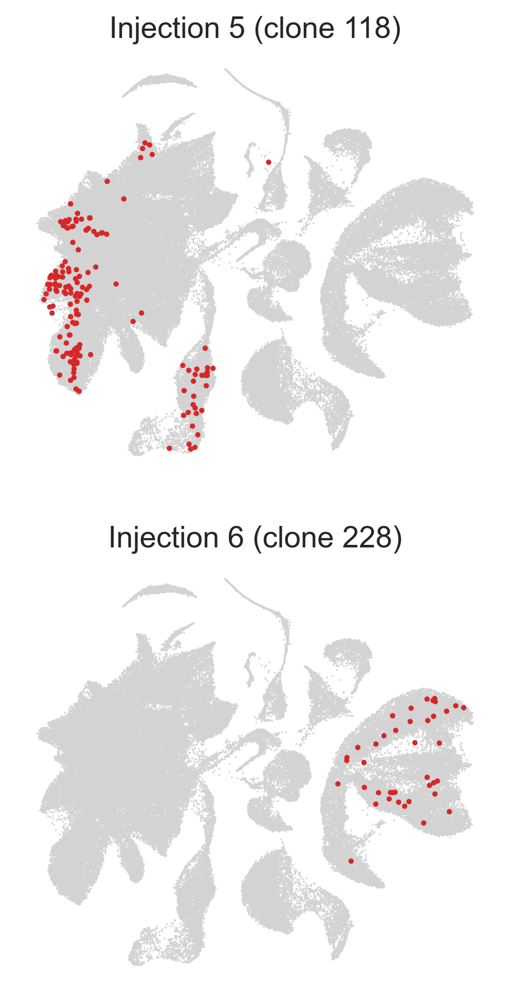

In [101]:
fig, axes = plt.subplots(nrows=2, figsize=(4, 8))

sc.pl.umap(adata_trunk, ax=axes[0], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection5:clone_118"], ax=axes[0],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3], title="Injection 5 (clone 118)")

sc.pl.umap(adata_trunk, ax=axes[1], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection6:clone_228"], ax=axes[1],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3], title="Injection 6 (clone 228)")

plt.savefig("../figures/fig1/examples_of_clones.pdf", bbox_inches="tight")

In [30]:
l2_palette_trunk = {
    "Autonomic HOXB": "#a9a9a9",
    "Autonomic bridge": "#2f4f4f",
    "CNS": "#556b2f",
    "CNS progenitor": "#6b8e23",
    "Cardiac fibroblasts": "#a0522d",
    "Cardiac muscle": "#a52a2a",
    "Chondroblasts": "#2e8b57",
    "Chromaffin": "#228b22",
    "Connective mesenchyme": "#191970",
    "Dermal fibroblasts": "#708090",
    "Dermal mesenchyme": "#483d8b",
    "Dorsal excitatory": "#5f9ea0",
    "Dorsal excitatory lateral": "#bc8f8f",
    "Dorsal inhibitory": "#663399",
    "Dorsal inhibitory lateral": "#bdb76b",
    "Dorsal progenitor medial": "#cd853f",
    "Duct mesenchyme": "#4682b4",
    "Endothelial cells": "#000080",
    "Epicardium": "#d2691e",
    "Epithelial cells": "#9acd32",
    "Erythrocytes": "#20b2aa",
    "Glia": "#32cd32",
    "IVD": "#daa520",
    "Immune cells": "#8fbc8f",
    "Kidney": "#800080",
    "Liver": "#b03060",
    "Melanocytes": "#d2b48c",
    "Meningeal fibroblasts": "#66cdaa",
    "Mesenchyme": "#9932cc",
    "Middle mesenchyme": "#ff4500",
    "Muscle": "#ffa500",
    "Neuron autonomic": "#ffd700",
    "Osteoblasts": "#ffff00",
    "Pericytes": "#c71585",
    "Preskeletal chondro IVD": "#0000cd",
    "Preskeletal mesenchyme": "#7cfc00",
    "Preskeletal osteo chondrocytes": "#00ff00",
    "Preskeletal osteo fibroblasts": "#00ff7f",
    "Sensory": "#4169e1",
    "Skin": "#dc143c",
    "Tenocytes": "#00ffff",
    "VSMC": "#9370db",
    "Ventral motor progenitor": "#0000ff",
    "Ventral neurons": "#a020f0",
    "Ventral progenitors": "#f08080",
    "Visceral mesenchyme": "#ff6347",
}

l2_palette_face = {
    "Albumin": "#a9a9a9",
    "CNS Glu": "#2f4f4f",
    "CNS Neuron": "#556b2f",
    "CNS progenitors": "#6b8e23",
    "Chchd10": "#a0522d",
    "Chondroblast": "#a52a2a",
    "Chondrocyte": "#2e8b57",
    "Chondroprogenitors": "#228b22",
    "Connective": "#191970",
    "Dental mesenchyme": "#708090",
    "Dental mesenchyme incisor": "#483d8b",
    "Dermal fibroblast": "#5f9ea0",
    "Dermal mesenchyme": "#bc8f8f",
    "Endothelial cells": "#663399",
    "Epithelial cells": "#bdb76b",
    "Erbb4 Hoxb8": "#cd853f",
    "Erythrocytes": "#4682b4",
    "Fibroblasts": "#000080",
    "Glia": "#d2691e",
    "Immune cells": "#9acd32",
    "MSC": "#20b2aa",
    "Melanocytes": "#32cd32",
    "Meningeal fibroblast": "#daa520",
    "Mesenchyme Dlx Middle ": "#8fbc8f",
    "Mesenchyme Dlx lower": "#800080",
    "Mesenchyme Hox": "#b03060",
    "Mesenchyme NR2F1a": "#d2b48c",
    "Mesenchyme NR2F2b": "#66cdaa",
    "Mesenchyme Pitx1Barx1": "#9932cc",
    "Mesenchyme Progenitor Sox5": "#ff4500",
    "Mesenchyme Sh3gl3": "#ffa500",
    "Mesenchyme Side Thbs4 ": "#ffd700",
    "Mesenchyme Tbx1": "#ffff00",
    "Mesenchyme Vav3": "#c71585",
    "Muscle": "#0000cd",
    "Nasal mesenchyme": "#7cfc00",
    "Neurod6": "#00ff00",
    "Neuroepithelial": "#00ff7f",
    "Osteoblast": "#4169e1",
    "Osteoprogenitor": "#dc143c",
    "Otp Cartpt": "#00ffff",
    "Parasympathetic": "#9370db",
    "Periocular mesenchyme": "#0000ff",
    "Perivascular": "#a020f0",
    "Pou3f1": "#f08080",
    "Rax": "#ff6347",
    "Retinal ganglion": "#d8bfd8",
    "Sensory A": "#ff00ff",
    "Skin": "#db7093",
    "Sympathetic": "#eee8aa",
    "Tongue mesenchyme": "#6495ed",
    "Doublets": "#888888",
}

adata_face.uns["celltype_l2_colors"] = [l2_palette_face[cat] for cat in adata_face.obs.celltype_l2.cat.categories]
adata_trunk.uns["celltype_l2_colors"] = [l2_palette_trunk[cat] for cat in adata_trunk.obs.celltype_l2.cat.categories]

In [ ]:
sc.pl.umap(adata_trunk, color="celltype_l2", frameon=False, title="Trunk")
sc.pl.umap(adata_face, color="celltype_l2", frameon=False, title="Face")

In [4]:
adata_trunk_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_mes_E13_clonal_clusters.h5ad")
adata_trunk_neur = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_neur_E13_clonal_clusters.h5ad")
adata_trunk_glia = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_glia_E13_clonal_clusters.h5ad")
adata_trunk_other = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_other_E13_clonal_clusters.h5ad")
adata_trunk_NC = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_NC_E13_clonal_clusters.h5ad")

In [26]:
adata_face_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_mes_E13_clonal_clusters.h5ad")
adata_face_neur = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_neur_E13_clonal_clusters.h5ad")
adata_face_other = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_other_E13_clonal_clusters.h5ad")

In [31]:
for adata in [adata_face, adata_face_mes, adata_face_other, adata_face_neur]:
    adata.uns["celltype_l2_colors"] = [l2_palette_face[cat] for cat in adata.obs.celltype_l2.cat.categories]

In [ ]:
sc.pl.umap(adata_face_mes, color="celltype_l2", frameon=False, save="face_mes.pdf")

In [ ]:
adata_face_mes.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata_face_mes, groupby="celltype_l2")
sc.pl.rank_genes_groups_dotplot(adata_face_mes, min_logfoldchange=2, n_genes=3, standard_scale="var", save="Mes_head.pdf")

In [92]:
cmap = dict(zip([str(i) for i in range(20)], sns.color_palette()))
groups = list(cmap.keys()) + ["20"]
cmap["NA"] = "#ffffff"
cmap["20"] = "#191970"

In [ ]:
adata = adata_trunk_other
group = "clones_clusters_2"

adata.uns[f"{group}_colors"] = [cmap[i] for i in adata.obs[group].cat.categories]
sc.pl.umap(adata, color=group, groups=groups, s=10, save=f"trunk_other_{group}.pdf")

In [ ]:
sc.pl.umap(adata_face_neur, color="celltype_l2", frameon=False, save="face_neur.pdf")

In [ ]:
adata_face_neur.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata_face_neur, groupby="celltype_l2")
sc.pl.rank_genes_groups_dotplot(adata_face_neur, min_logfoldchange=2, n_genes=3, standard_scale="var", save="Neurons_head.pdf")

In [ ]:
sc.pl.umap(adata_trunk_other, color="celltype_l2", frameon=False, save="trunk_other.pdf")

In [ ]:
adata_face_other.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata_face_other, groupby="celltype_l2")
sc.pl.rank_genes_groups_dotplot(adata_face_other, min_logfoldchange=2, n_genes=3, standard_scale="var", save="Other_head.pdf")

In [65]:
for adata in [adata_trunk_mes, adata_trunk_neur, adata_trunk_glia, adata_trunk_other, adata_trunk_NC]:
    adata.uns["celltype_l2_colors"] = [l2_palette_trunk[cat] for cat in adata.obs.celltype_l2.cat.categories]

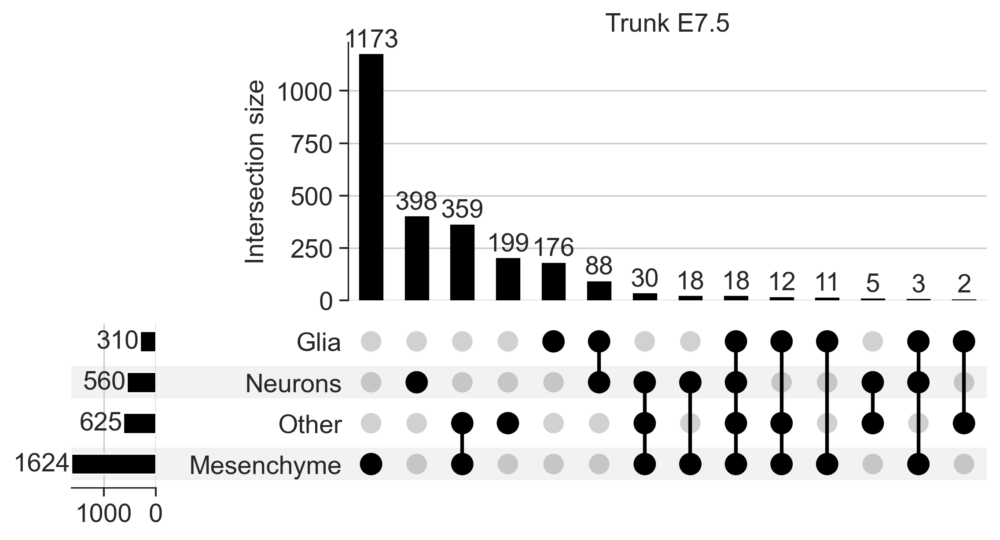

In [197]:
timepoint = "E7.5"

n_clones = len(set(adata_trunk.obs[adata_trunk.obs[f"{timepoint}:clones"] != "NA"][f"{timepoint}:clones"]))

df_tmp = adata_trunk.obs[adata_trunk.obs[f"{timepoint}:clones"] != "NA"]
df_tmp[f"{timepoint}:clones"] = df_tmp[f"{timepoint}:clones"].astype(str)
df_tmp["celltype_l0"] = df_tmp["celltype_l0"].astype(str)
df_tmp = [list(i) for i in df_tmp.groupby([f"{timepoint}:clones"])["celltype_l0"].unique()]
df_tmp = upsetplot.from_memberships(df_tmp)

axes = upsetplot.UpSet(df_tmp, subset_size="count", sort_by="cardinality",
                       show_counts=True, min_subset_size=(n_clones * 0)).plot()
axes["intersections"].set_title("Trunk " + timepoint)

plt.savefig(f"../figures/fig1/{timepoint}_Trunk_UpSet.pdf", bbox_inches="tight")

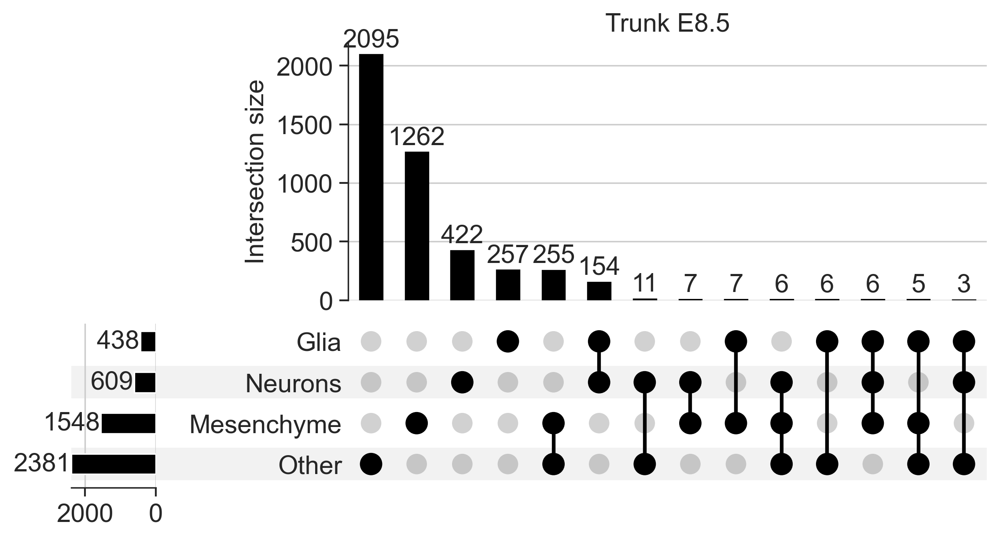

In [200]:
timepoint = "E8.5"

n_clones = len(set(adata_trunk.obs[adata_trunk.obs[f"{timepoint}:clones"] != "NA"][f"{timepoint}:clones"]))

df_tmp = adata_trunk.obs[adata_trunk.obs[f"{timepoint}:clones"] != "NA"]
df_tmp[f"{timepoint}:clones"] = df_tmp[f"{timepoint}:clones"].astype(str)
df_tmp["celltype_l0"] = df_tmp["celltype_l0"].astype(str)
df_tmp = [list(i) for i in df_tmp.groupby([f"{timepoint}:clones"])["celltype_l0"].unique()]
df_tmp = upsetplot.from_memberships(df_tmp)

axes = upsetplot.UpSet(df_tmp, subset_size="count", sort_by="cardinality",
                       show_counts=True, min_subset_size=(n_clones * 0)).plot()
axes["intersections"].set_title("Trunk " + timepoint)

plt.savefig(f"../figures/fig1/{timepoint}_Trunk_UpSet.pdf", bbox_inches="tight")

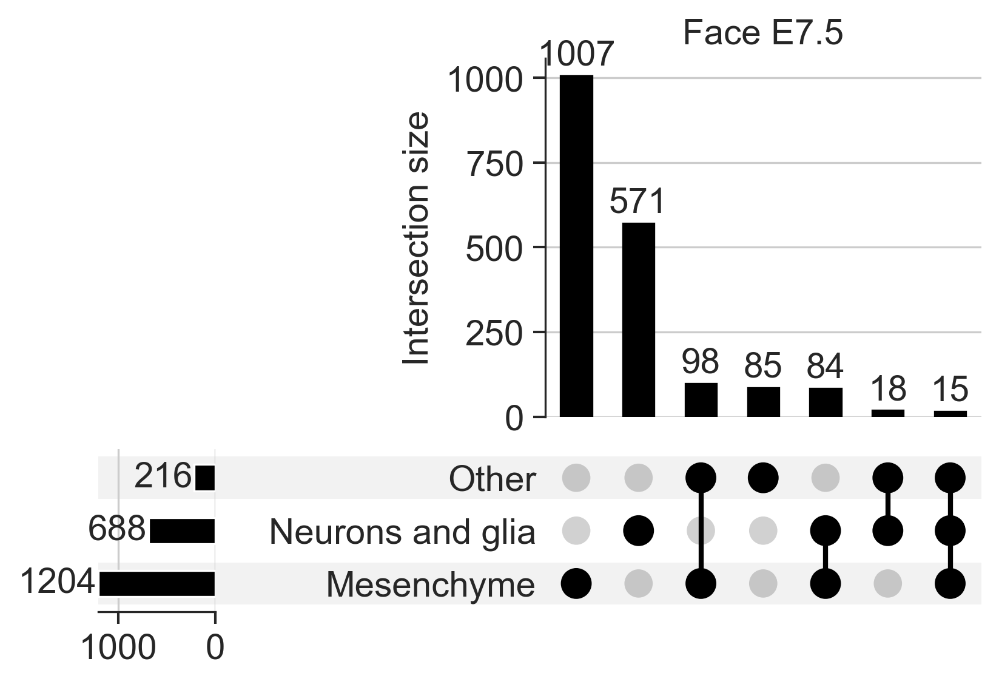

In [199]:
timepoint = "E7.5"

n_clones = len(set(adata_face.obs[adata_face.obs[f"{timepoint}:clones"] != "NA"][f"{timepoint}:clones"]))

df_tmp = adata_face.obs[adata_face.obs[f"{timepoint}:clones"] != "NA"]
df_tmp[f"{timepoint}:clones"] = df_tmp[f"{timepoint}:clones"].astype(str)
df_tmp["celltype_l0"] = df_tmp["celltype_l0"].astype(str)
df_tmp = [list(i) for i in df_tmp.groupby([f"{timepoint}:clones"])["celltype_l0"].unique()]
df_tmp = upsetplot.from_memberships(df_tmp)

axes = upsetplot.UpSet(df_tmp, subset_size="count", sort_by="cardinality",
                       show_counts=True, min_subset_size=(n_clones * 0)).plot()
axes["intersections"].set_title("Face " + timepoint)

plt.savefig(f"../figures/fig1/{timepoint}_Face_UpSet.pdf", bbox_inches="tight")

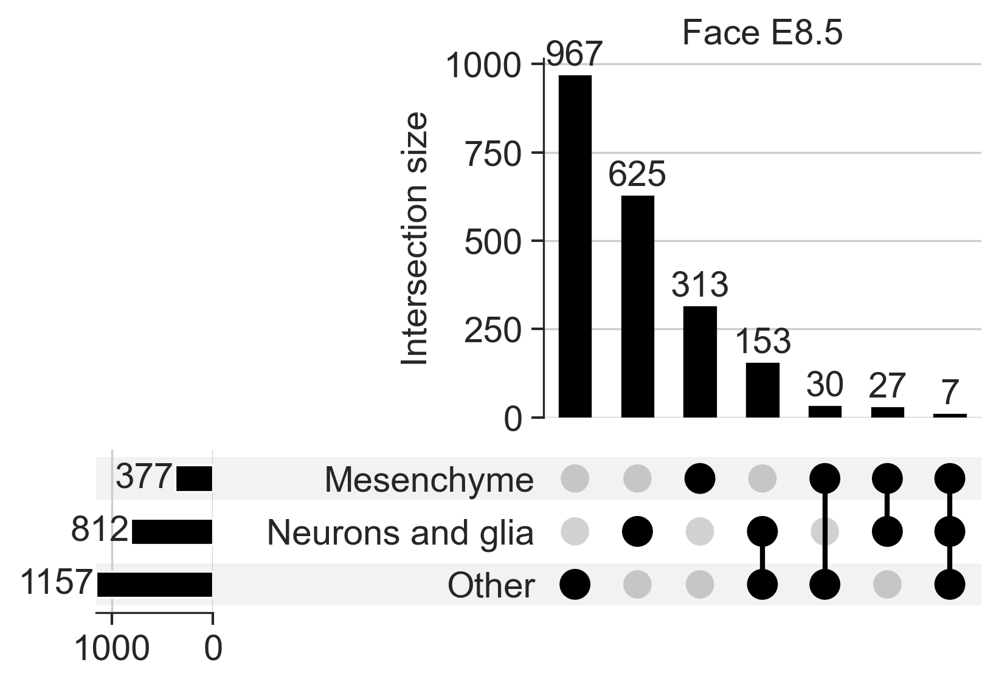

In [201]:
timepoint = "E8.5"

n_clones = len(set(adata_face.obs[adata_face.obs[f"{timepoint}:clones"] != "NA"][f"{timepoint}:clones"]))

df_tmp = adata_face.obs[adata_face.obs[f"{timepoint}:clones"] != "NA"]
df_tmp[f"{timepoint}:clones"] = df_tmp[f"{timepoint}:clones"].astype(str)
df_tmp["celltype_l0"] = df_tmp["celltype_l0"].astype(str)
df_tmp = [list(i) for i in df_tmp.groupby([f"{timepoint}:clones"])["celltype_l0"].unique()]
df_tmp = upsetplot.from_memberships(df_tmp)

axes = upsetplot.UpSet(df_tmp, subset_size="count", sort_by="cardinality",
                       show_counts=True, min_subset_size=(n_clones * 0)).plot()
axes["intersections"].set_title("Face " + timepoint)

plt.savefig(f"../figures/fig1/{timepoint}_Face_UpSet.pdf", bbox_inches="tight")

<Axes: xlabel='UMAP1', ylabel='UMAP2'>

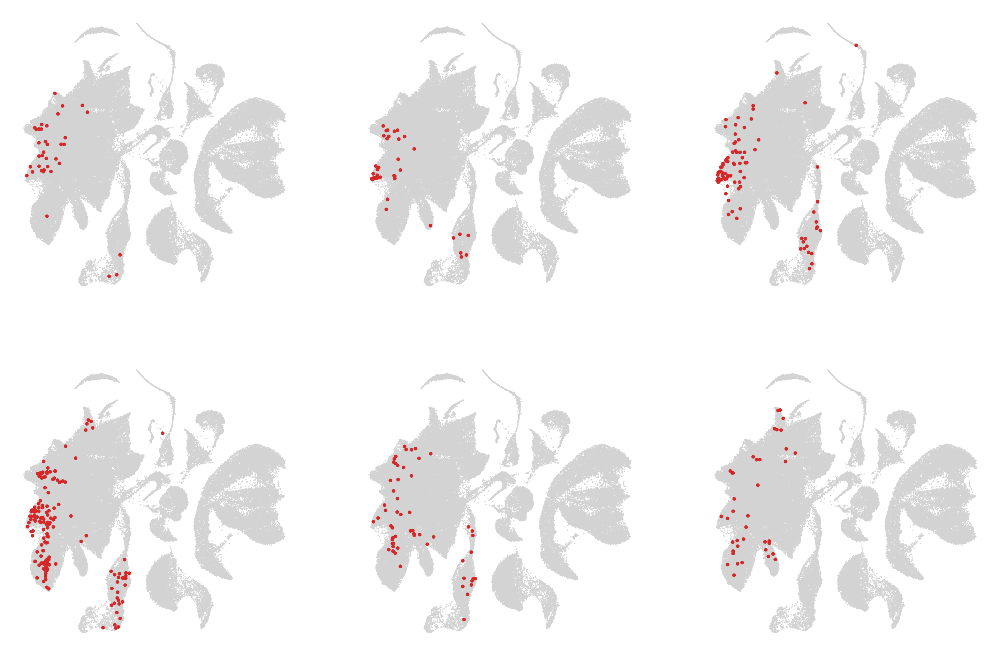

In [235]:
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(12, 8))

sc.pl.umap(adata_trunk, ax=axes[0, 0], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection5:clone_110"], ax=axes[0, 0],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3])
sc.pl.umap(adata_trunk, ax=axes[0, 1], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection5:clone_112"], ax=axes[0, 1],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3])
sc.pl.umap(adata_trunk, ax=axes[0, 2], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection5:clone_113"], ax=axes[0, 2],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3])

sc.pl.umap(adata_trunk, ax=axes[1, 0], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection5:clone_118"], ax=axes[1, 0],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3])
sc.pl.umap(adata_trunk, ax=axes[1, 1], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection5:clone_133"], ax=axes[1, 1],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3])
sc.pl.umap(adata_trunk, ax=axes[1, 2], show=False, frameon=False, s=3)
sc.pl.umap(adata_trunk[adata_trunk.obs["E7.5:clones"] == "injection5:clone_137"], ax=axes[1, 2],
           show=False, frameon=False, s=25, na_color=sns.color_palette()[3])

<Axes: xlabel='UMAP1', ylabel='UMAP2'>

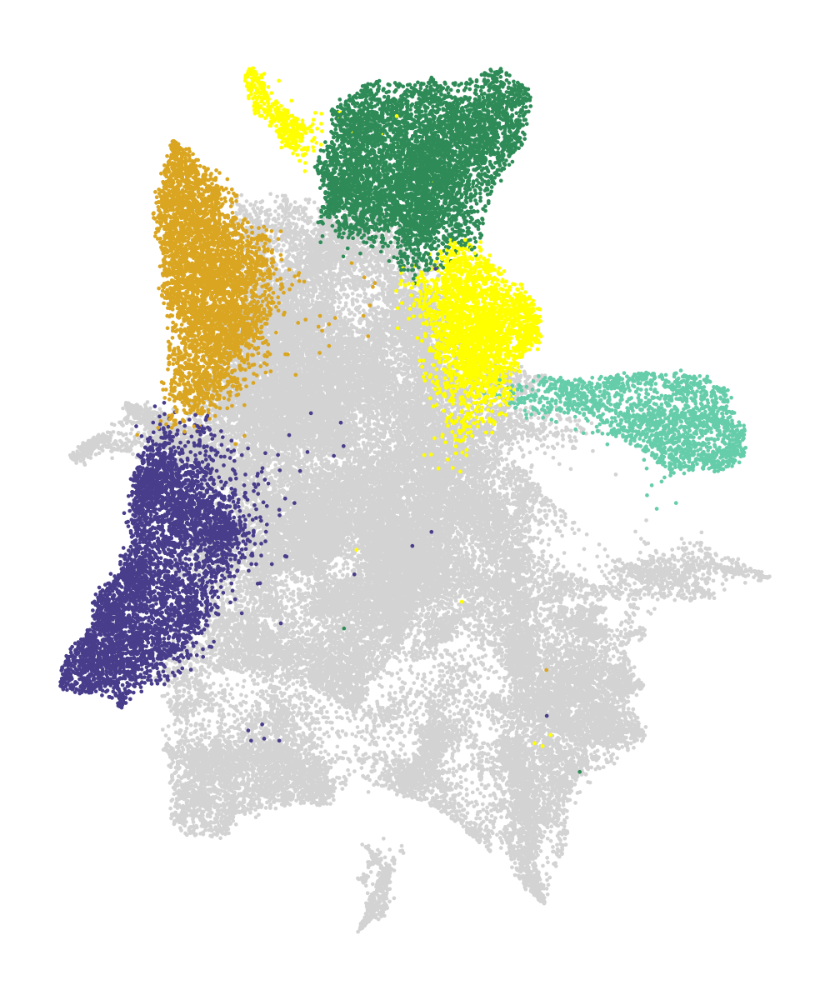

In [248]:
fig, ax = plt.subplots(figsize=(4, 5))
sc.pl.umap(adata_trunk_mes, color="celltype_l2", groups=["Osteoblasts", "Chondroblasts", "Meningeal fibroblasts", "IVD", "Dermal mesenchyme"],
           frameon=False, legend_loc=None, title="", ax=ax, show=False, s=5)

In [ ]:
description = {
    "Whole trunk": adata_trunk,
    "Glia in trunk": adata_trunk_glia,
    "Mesenchyme in trunk": adata_trunk_mes,
    "Neurons in trunk": adata_trunk_neur,
    "Other cells in trunk": adata_trunk_other,
    "NC-derived cells in trunk": adata_trunk_NC,
}

for name in description:
    fig, ax = plt.subplots(figsize=(4, 5))
    
    sc.pl.umap(description[name], color="celltype_l2", frameon=False, title="", ax=ax, show=False, s=4)
    
    embedding = name.replace(" ", "_")
    plt.savefig(f"../figures/embeddings/{embedding}_l2.pdf", bbox_inches="tight")

In [ ]:
description = {
    "Whole trunk": adata_trunk,
    "Glia in trunk": adata_trunk_glia,
    "Mesenchyme in trunk": adata_trunk_mes,
    "Neurons in trunk": adata_trunk_neur,
    "Other cells in trunk": adata_trunk_other,
    "NC-derived cells in trunk": adata_trunk_NC,
}

for name in description:
    fig, ax = plt.subplots(figsize=(4, 5))
    
    sc.pl.umap(description[name], color="celltype_l3", frameon=False, title="", ax=ax, show=False, s=4)
    
    embedding = name.replace(" ", "_")
    plt.savefig(f"../figures/embeddings/{embedding}_l3.pdf", bbox_inches="tight")

In [ ]:
adata_trunk_mes.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata_trunk_mes, groupby="celltype_l2")
sc.pl.rank_genes_groups_dotplot(adata_trunk_mes, min_logfoldchange=2, n_genes=3, standard_scale="var", save="Mes_trunk_markers.pdf")

In [19]:
adata_trunk_neur = adata_trunk_neur[~adata_trunk_neur.obs.celltype_l2.isin(["Sensory", "Melanocytes"])].copy()
for adata in [adata_trunk_neur]:
    adata.uns["celltype_l2_colors"] = [l2_palette_trunk[cat] for cat in adata.obs.celltype_l2.cat.categories]

In [ ]:
sc.pl.umap(adata_trunk_neur, color="celltype_l2", save="neurons_trunk.pdf")

In [ ]:
adata_trunk_neur.uns["log1p"]["base"] = None
sc.tl.rank_genes_groups(adata_trunk_neur, groupby="celltype_l2")
sc.pl.rank_genes_groups_dotplot(adata_trunk_neur, min_logfoldchange=2, n_genes=3, standard_scale="var", save="Neur_trunk_markers.pdf")

Text(0.5, 1.0, 'Full correlation')

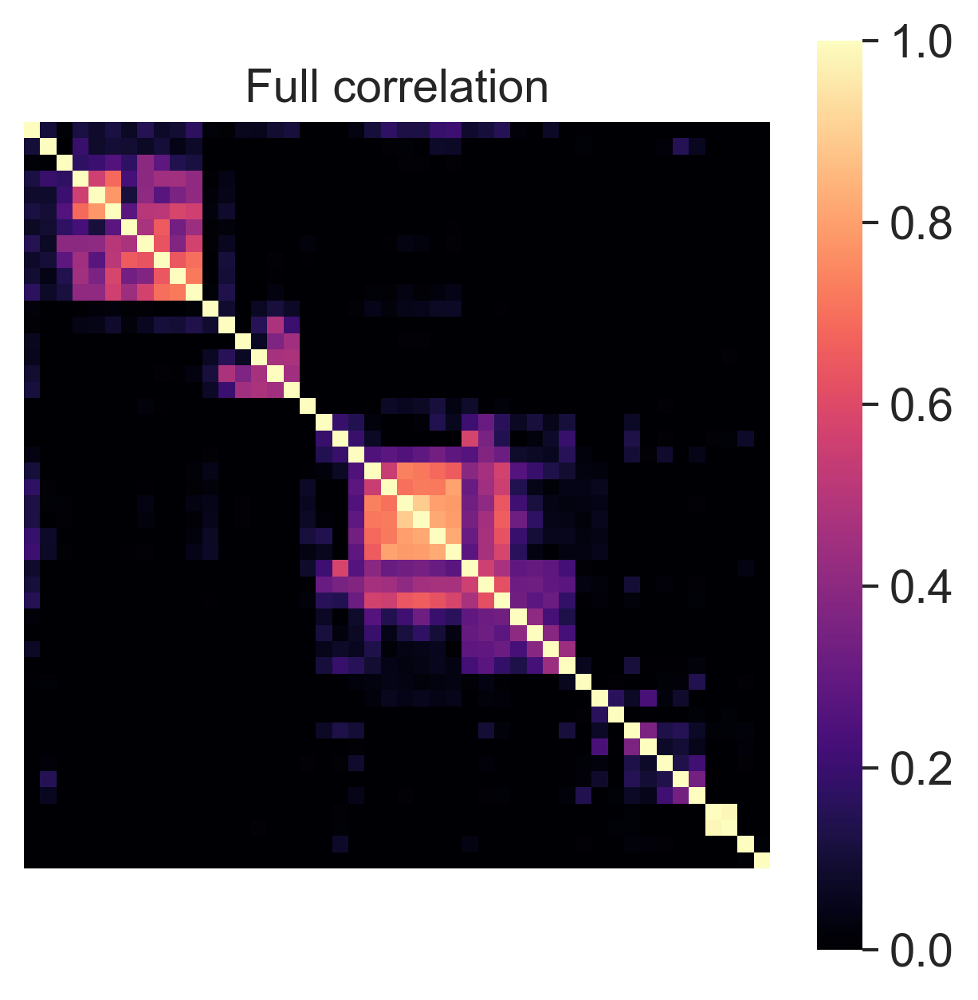

In [10]:
fig, ax = plt.subplots(figsize=(5, 5))

data = pd.DataFrame(
    np.corrcoef(adata_clones.X.T),
    index=list(adata_clones.var_names),
    columns=list(adata_clones.var_names),
)
ct_order = dendrogram(linkage(data, method="average", metric="correlation"), no_plot=True)["leaves"]
data = data[data.columns[ct_order]].loc[data.columns[ct_order]]

sns.heatmap(
    data,
    square=True,
    xticklabels=(),
    yticklabels=(),
    vmin=0,
    vmax=1,
    ax=ax,
    cmap="magma"
)
ax.set_title("Full correlation")

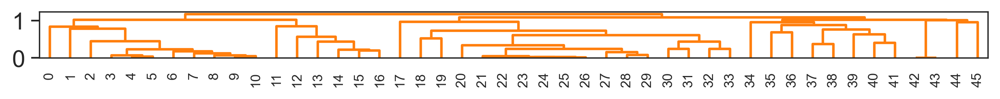

In [18]:
fig, ax = plt.subplots(figsize=(10, 0.5))
_ = dendrogram(linkage(data, method="average", metric="correlation"), color_threshold=200, ax=ax)
plt.savefig("../figures/fig1/dendro.pdf")

Text(0.5, 1.0, 'Difference of correlation')

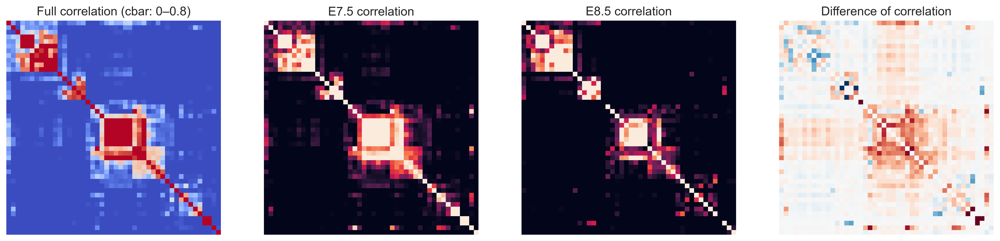

In [23]:
fig, axes = plt.subplots(figsize=(20, 5), ncols=4)

data = pd.DataFrame(
    np.corrcoef(adata_clones.X.T),
    index=list(adata_clones.var_names),
    columns=list(adata_clones.var_names),
)
ct_order = dendrogram(linkage(data, method="average", metric="correlation"), no_plot=True)["leaves"]
data = data[data.columns[ct_order]].loc[data.columns[ct_order]]

sns.heatmap(
    data,
    square=True,
    xticklabels=(),
    yticklabels=(),
    vmin=0,
    vmax=0.5,
    ax=axes[0],
    cbar=None,
    cmap="coolwarm"
)
axes[0].set_title("Full correlation (cbar: 0–0.8)")

data_E7 = pd.DataFrame(
    np.corrcoef(adata_clones[adata_clones.obs.injection_time == "E7.5"].X.T),
    index=list(adata_clones[adata_clones.obs.injection_time == "E7.5"].var_names),
    columns=list(adata_clones[adata_clones.obs.injection_time == "E7.5"].var_names),
)
data_E7 = data_E7[data_E7.columns[ct_order]].loc[data_E7.columns[ct_order]]

sns.heatmap(
    data_E7,
    square=True,
    xticklabels=(),
    yticklabels=(),
    vmin=0,
    vmax=0.5,
    ax=axes[1],
    cbar=None,
)

axes[1].set_title("E7.5 correlation")

data_E8 = pd.DataFrame(
    np.corrcoef(adata_clones[adata_clones.obs.injection_time == "E8.5"].X.T),
    index=list(adata_clones[adata_clones.obs.injection_time == "E8.5"].var_names),
    columns=list(adata_clones[adata_clones.obs.injection_time == "E8.5"].var_names),
)
data_E8 = data_E8[data_E8.columns[ct_order]].loc[data_E8.columns[ct_order]].fillna(0)

sns.heatmap(
    data_E8,
    square=True,
    xticklabels=(),
    yticklabels=(),
    vmin=0,
    vmax=0.5,
    ax=axes[2],
    cbar=None,
)

axes[2].set_title("E8.5 correlation")

sns.heatmap(
    data_E7 - data_E8,
    square=True,
    xticklabels=(),
    yticklabels=(),
    ax=axes[3],
    cbar=False,
    vmin=-0.5,
    vmax=0.5,
    cmap="RdBu_r",
)
axes[3].set_title("Difference of correlation")

# plt.savefig(f"../figures/fig2/coorelations_small.pdf", bbox_inches="tight")

In [569]:
E8_clones = adata_clones[adata_clones.obs.injection_time == "E8.5"].to_df().astype(int)
E7_clones = adata_clones[adata_clones.obs.injection_time == "E7.5"].to_df().astype(int)

ct_order_expl = data.columns[ct_order]

In [535]:
def subsample_clone(df):
    from random import sample

    df_subsampled = pd.DataFrame(dict(zip(
        df.index, [
            dict(pd.Series(sample(sum(
                [[index] * counts for index, counts in zip(df.loc[clone].index, df.loc[clone]) if counts > 0 ], []
            ), k=10)).value_counts())
            for clone in df.index
        ]
    ))).fillna(0).astype(int).T
    
    for ct in df.columns[~df.columns.isin(df_subsampled.columns)]:
        df_subsampled[ct] = 0
        
    return df_subsampled

In [ ]:
n_iter = 5000
differences = None

for i in tqdm(range(n_iter)):
    E7_subsampled = subsample_clone(E7_clones)
    E7_subsampled = E7_subsampled.corr(method="spearman")[ct_order_expl].loc[ct_order_expl].fillna(0)
    
    E8_subsampled = subsample_clone(E8_clones)
    E8_subsampled = E8_subsampled.corr(method="spearman")[ct_order_expl].loc[ct_order_expl].fillna(0)
    
    if differences is None:
        differences = E7_subsampled - E8_subsampled
        E7s_subsampled = E7_subsampled
        E8s_subsampled = E8_subsampled
    else:
        differences += E7_subsampled - E8_subsampled
        E7s_subsampled += E7_subsampled
        E8s_subsampled += E8_subsampled
        
differences = differences / n_iter
E7s_subsampled = E7s_subsampled / n_iter
E8s_subsampled = E8s_subsampled / n_iter

 28%|██▊       | 1377/5000 [14:40<38:19,  1.58it/s]

In [616]:
fig, axes = plt.subplots(figsize=(60, 15), ncols=4)

data = pd.DataFrame(
    np.corrcoef(adata_clones.X.T),
    index=list(adata_clones.var_names),
    columns=list(adata_clones.var_names),
)
ct_order = dendrogram(linkage(data, method="average", metric="correlation"), no_plot=True)["leaves"]
correct_cts = data.columns[ct_order]
data = data[correct_cts].loc[correct_cts]

sns.heatmap(
    data,
    square=True,
    xticklabels=correct_cts,
    yticklabels=correct_cts,
    vmin=0,
    vmax=0.8,
    ax=axes[0],
    cbar=None,
)
axes[0].set_title("Full correlation (cbar: 0–0.8)")

data_E7 = pd.DataFrame(
    np.corrcoef(adata_clones[adata_clones.obs.injection_time == "E7.5"].X.T),
    index=list(adata_clones[adata_clones.obs.injection_time == "E7.5"].var_names),
    columns=list(adata_clones[adata_clones.obs.injection_time == "E7.5"].var_names),
)
data_E7 = data_E7[correct_cts].loc[correct_cts]

sns.heatmap(
    data_E7,
    square=True,
    xticklabels=correct_cts,
    yticklabels=correct_cts,
    vmin=0,
    vmax=0.8,
    ax=axes[1],
    cbar=None,
)

axes[1].set_title("E7.5 correlation")

data_E8 = pd.DataFrame(
    np.corrcoef(adata_clones[adata_clones.obs.injection_time == "E8.5"].X.T),
    index=list(adata_clones[adata_clones.obs.injection_time == "E8.5"].var_names),
    columns=list(adata_clones[adata_clones.obs.injection_time == "E8.5"].var_names),
)
data_E8 = data_E8[correct_cts].loc[correct_cts].fillna(0)

sns.heatmap(
    data_E8,
    square=True,
    xticklabels=correct_cts,
    yticklabels=correct_cts,
    vmin=0,
    vmax=0.8,
    ax=axes[2],
    cbar=None,
)

axes[2].set_title("E8.5 correlation")

sns.heatmap(
    data_E7 - data_E8,
    square=True,
    xticklabels=correct_cts,
    yticklabels=correct_cts,
    ax=axes[3],
    cbar=False,
    vmin=-0.5,
    vmax=0.5,
    cmap="RdBu_r",
)
axes[3].set_title("Difference of correlation")

fig.tight_layout()

plt.savefig(f"../figures/fig2/coorelations_big.pdf", bbox_inches="tight")

In [618]:
adata_clones_head = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/E13_face_clonal_embedding.h5ad")
adata_clones_head = adata_clones_head[:, adata_clones_head.X.sum(axis=0) > 0]

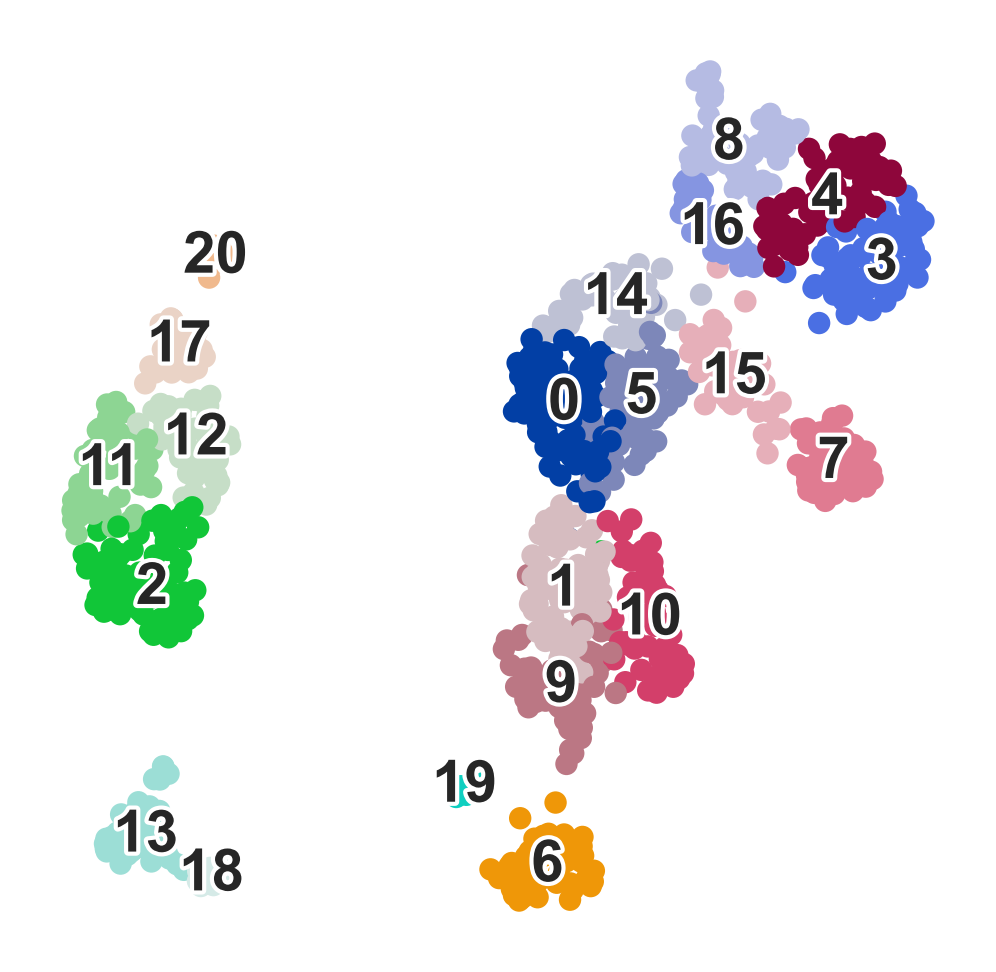

In [750]:
sc.pl.umap(adata_clones_head, color="leiden_2", legend_loc="on data", frameon=False, title="",
           legend_fontoutline=2, save="head_clones_umap.pdf")

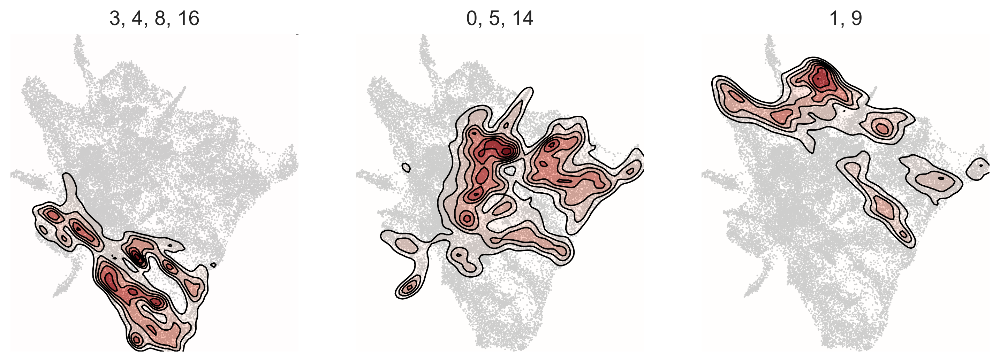

In [1007]:
adata_face_mes.obs["clones_clusters_1_new"] = [
    "2+4" if i in ["4", "2"] else i for i in
    adata_face_mes.obs["clones_clusters_1"]
]

fig, axes = plt.subplots(ncols=3, figsize=(12, 4))

sl.pl.kde(adata_face_mes, groupby="clones_clusters_1_new", title="3, 4, 8, 16", group="2+4", ax=axes[0])
sl.pl.kde(adata_face_mes, groupby="clones_clusters_1_new", title="0, 5, 14", group="0", ax=axes[1])
sl.pl.kde(adata_face_mes, groupby="clones_clusters_1_new", title="1, 9", group="1", ax=axes[2])

plt.savefig("../figures/fig4/kde_face.pdf", bbox_inches="tight")

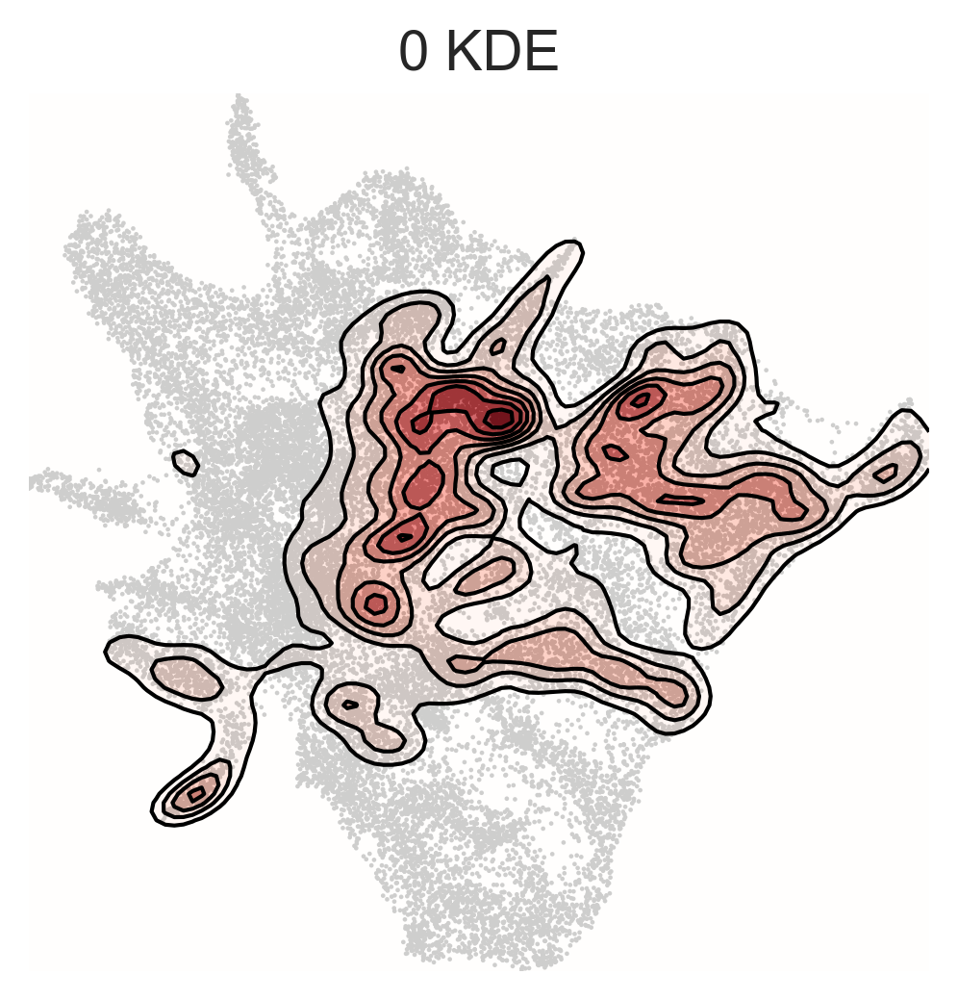

In [986]:
sl.pl.kde(adata_face_mes, groupby="clones_clusters_1", group="0")

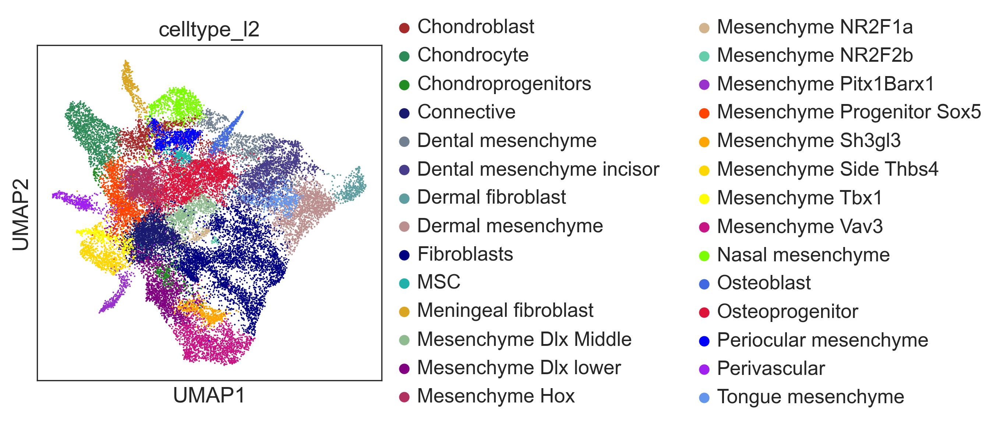

In [984]:
sc.pl.umap(adata_face_mes, color="celltype_l2")

In [ ]:
ct_order = [
    "Connective", "Fibroblasts", "Tongue mesenchyme", "Dermal fibroblast",
    "Dermal mesenchyme", "MSC", "Osteoblast", "Dental mesenchyme incisor",
    "Osteoprogenitor", "Mesenchyme Dlx Middle ", "Chondroblast", "Dental mesenchyme",
    "Chondrocyte", "Nasal mesenchyme", "Mesenchyme Sh3gl3", "Mesenchyme Dlx lower",
    "Mesenchyme Vav3", "Mesenchyme Tbx1", "Mesenchyme Side Thbs4 ",
    "Mesenchyme Progenitor Sox5", "Mesenchyme Hox", "Muscle", "Meningeal fibroblast",
    "Perivascular", "Periocular mesenchyme", "Neurod6", "Pou3f1", "Erbb4 Hoxb8",
    "CNS progenitors", "CNS Neuron", "CNS Glu", "Rax", "Retinal ganglion",
    "Sympathetic", "Glia", "Sensory A", "Melanocytes", "Epithelial cells",
    "Neuroepithelial", "Skin"
]

adata_clones_head.obs["leiden_2"] = adata_clones_head.obs["leiden_2"].cat.reorder_categories([
    "0", "5", "14", "1", "9", "15", "4", "3", "16", "8", "7", "10", "2", "11", "12", "17", "20", 
    "6", "19", "13", "18"
])

ax = sc.pl.dotplot(
    adata_clones_head,
    var_names=ct_order,
    groupby="leiden_2",
    cmap="Reds",
    dendrogram=False,
    figsize=(13, 6),
    standard_scale="var",
    show=True,
    colorbar_title="mean(nCells)",
    size_title="Fraction of clones\nwith the fate (%)",
    save="ct_compos_dotplot_face.pdf"
)

In [723]:
adata_face_mes = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_mes_E13_clonal_clusters.h5ad")
adata_face_mes.uns["celltype_l2_colors"] = [l2_palette_face[cat] for cat in adata_face_mes.obs.celltype_l2.cat.categories]

In [842]:
adata_subset = adata_face_mes[adata_face_mes.obs.celltype_l2.isin(["Chondrocyte"])]
adata_subset.uns["log1p"]["base"] = None
n_cells = adata_subset.obs.clones_clusters_2.value_counts()
n_cells = n_cells[(n_cells > 40) & (n_cells.index != "NA")]
adata_subset = adata_subset[adata_subset.obs.clones_clusters_2.isin(n_cells.index)]

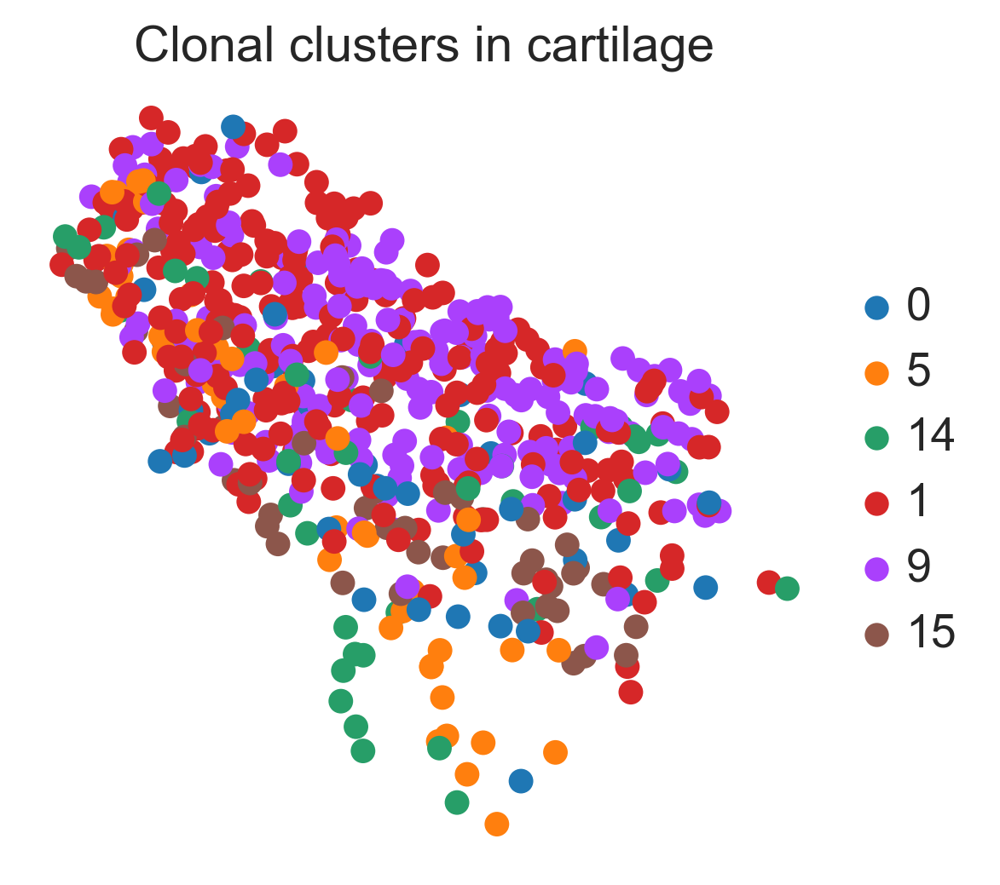

In [850]:
sc.pl.umap(adata_subset, color="clones_clusters_2", frameon=False,
           title="Clonal clusters in cartilage", save="cartilage_head_umap.pdf")

In [843]:
sc.tl.rank_genes_groups(adata_subset, groupby="clones_clusters_2")

In [936]:
group = "0"

df = sc.get.rank_genes_groups_df(adata_subset, group=group)
df[df.logfoldchanges > 1.5].head(15)

,names,scores,logfoldchanges,pvals,pvals_adj
2,Cdc42ep3,5.712328,1.829796,6.643560e-07,0.000154
3,Pantr1,5.465786,1.807718,1.630943e-06,0.000323
4,Pde4b,5.409092,1.924474,1.876238e-06,0.000366
6,Foxc2,5.325852,1.600008,2.494300e-06,0.000461
8,Pcp4,5.190887,5.186382,5.055600e-06,0.000739
12,Gdf10,4.849798,2.015885,1.424519e-05,0.001652
13,Sema5a,4.710989,1.820539,2.191375e-05,0.002296
15,Pdzrn4,4.369456,2.174386,6.699739e-05,0.005233
18,Slc35f1,4.158643,1.949800,1.338396e-04,0.009000
20,Mecom,4.143598,1.609913,1.334466e-04,0.008997


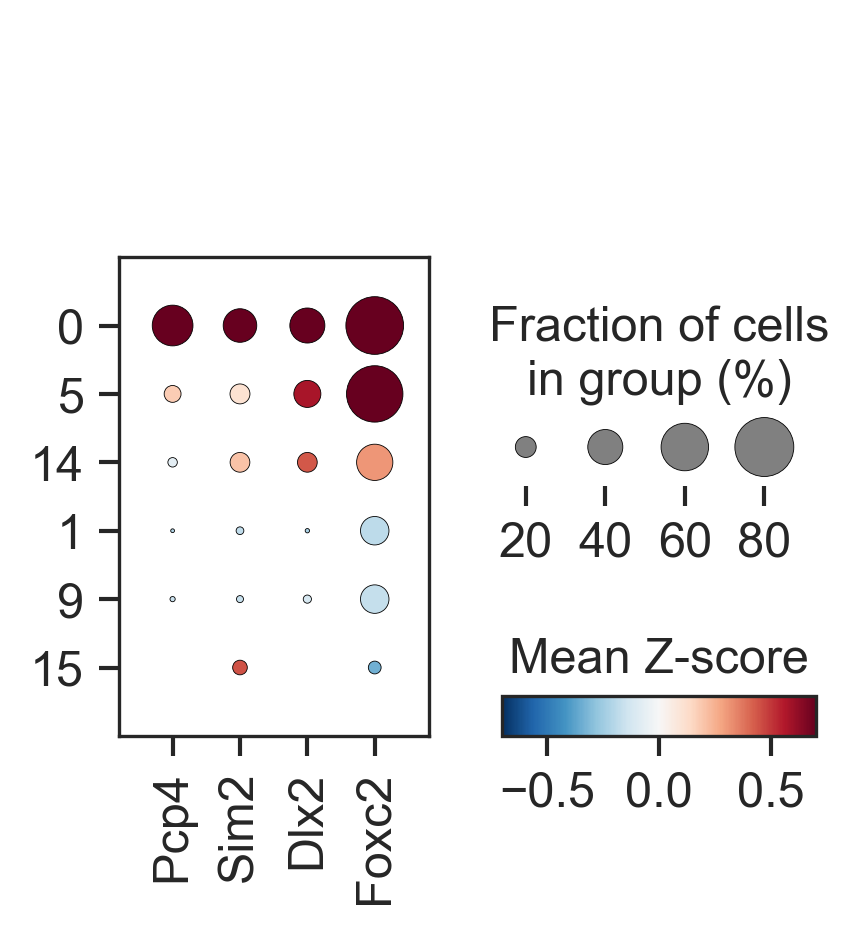

In [938]:
adata_subset.obs["clones_clusters_2"] = adata_subset.obs["clones_clusters_2"].cat.reorder_categories([
    "0", "5", "14", "1", "9", "15"
])
adata_subset.layers["scaled"] = sc.pp.scale(adata_subset.X)
sc.pl.dotplot(
    adata_subset,
    var_names=[
        "Pcp4", "Sim2", "Dlx2", "Foxc2"
    ],
    groupby="clones_clusters_2",
    layer="scaled",
    cmap="RdBu_r",
    vmin=-0.7,
    vmax=0.7,
    colorbar_title="Mean Z-score",
)

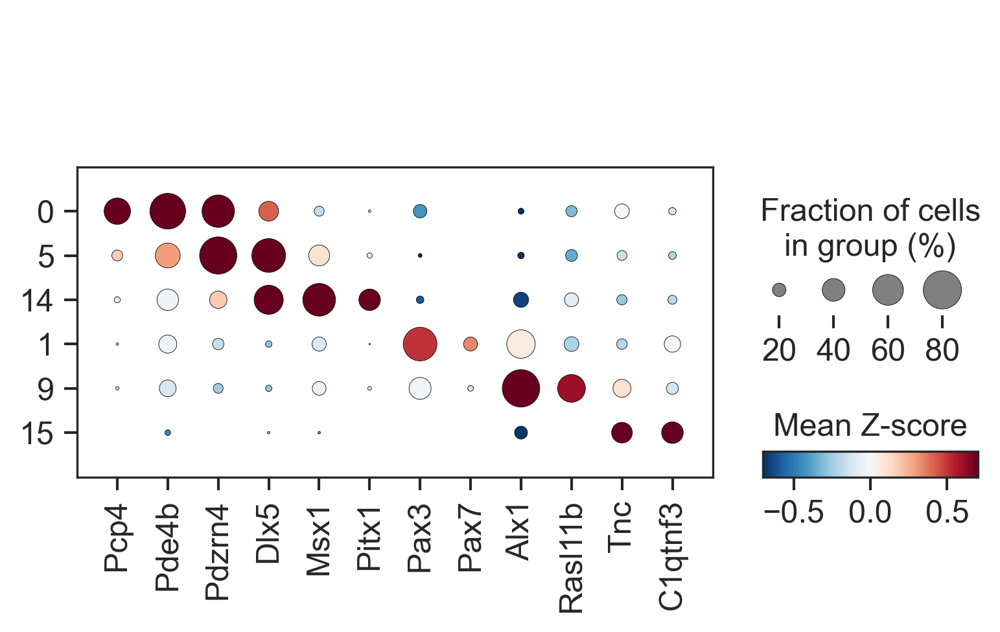

In [845]:
adata_subset.obs["clones_clusters_2"] = adata_subset.obs["clones_clusters_2"].cat.reorder_categories([
    "0", "5", "14", "1", "9", "15"
])
adata_subset.layers["scaled"] = sc.pp.scale(adata_subset.X)
sc.pl.dotplot(
    adata_subset,
    var_names=[
        "Pcp4", "Pde4b", "Pdzrn4", "Dlx5",
        "Msx1", "Pitx1", "Pax3", "Pax7",
        "Alx1", "Rasl11b",  "Tnc", "C1qtnf3",
    ],
    groupby="clones_clusters_2",
    layer="scaled",
    cmap="RdBu_r",
    vmin=-0.7,
    vmax=0.7,
    colorbar_title="Mean Z-score",
    save="cartilage_head_dotplot.pdf"
)

In [851]:
def flip_vertically(matrix):
    min_range = matrix[:, 1].min()
    max_range = matrix[:, 1].max()
    
    new_matrix = matrix.copy()
    new_matrix[:, 1] = max_range - matrix[:, 1] + min_range
    return new_matrix

In [852]:
def clear_adata(adata):
    for col in adata.obs.columns[adata.obs.columns.str.startswith("Regulon")]:
        del adata.obs[col]
    for col in adata.obs.columns[adata.obs.columns.str.startswith("Module")]:
        del adata.obs[col]
    for col in adata.var.columns[adata.var.columns.str.startswith("Regulon")]:
        del adata.var[col]
    for col in adata.var.columns[adata.var.columns.str.startswith("Module")]:
        del adata.var[col]
    del adata.layers["count"]

In [853]:
adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S1.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
adata = adata[adata.obsm["spatial"][:, 1] >= 230]
clear_adata(adata)
adatas = {"E1S1": adata.copy()}

adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S2.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
adata = adata[adata.obsm["spatial"][:, 1] >= -500]
clear_adata(adata)
adatas["E1S2"] = adata.copy()

adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S3.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
adata = adata[adata.obsm["spatial"][:, 1] >= 360]
clear_adata(adata)
adatas["E1S3"] = adata.copy()

adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S4.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
adata = adata[adata.obsm["spatial"][:, 1] >= 200]
clear_adata(adata)
adatas["E1S4"] = adata.copy()

In [1181]:
def calculate_signature(adatas, signature, signature_name="score"):
    for batch in adatas:
        sc.tl.score_genes(
            adatas[batch],
            gene_list=signature,
            score_name=signature_name,
        )
        
def combine_signatures(adatas, signature1, signature2, combined_name="combined", method="min"):
    if method == "min":
        f = np.minimum
    elif method == "max":
        f = np.maximum
    elif method == "mean":
        f = np.mean
    else:
        f = method
    for batch in adatas:
        adatas[batch].obs[combined_name] = f(adatas[batch].obs[signature1], adatas[batch].obs[signature2])
        
def signature_panel(adatas, score_name="score", height=8, s=7, **kwargs):
    fig, axes = plt.subplots(figsize=(12, height), ncols=2, nrows=2, dpi=300)

    i, j = 0, 0
    for batch in adatas:
        if i == 2:
            i = 0
            j = 1
        scv.pl.scatter(
            adatas[batch],
            basis="spatial",
            color=score_name,
            ax=axes[j, i],
            show=False,
            s=s,
            title=batch,
            **kwargs,
        )
        i += 1
        
    fig.suptitle(score_name, x=0.55)

In [864]:
sc.tl.rank_genes_groups(adata_face_mes, groups=["Chondrocyte"], groupby="celltype_l2")

In [872]:
chondro_signature = list(sc.get.rank_genes_groups_df(adata_face_mes, group="Chondrocyte").head(20).names)
calculate_signature(adatas, chondro_signature, "chondro_signature")

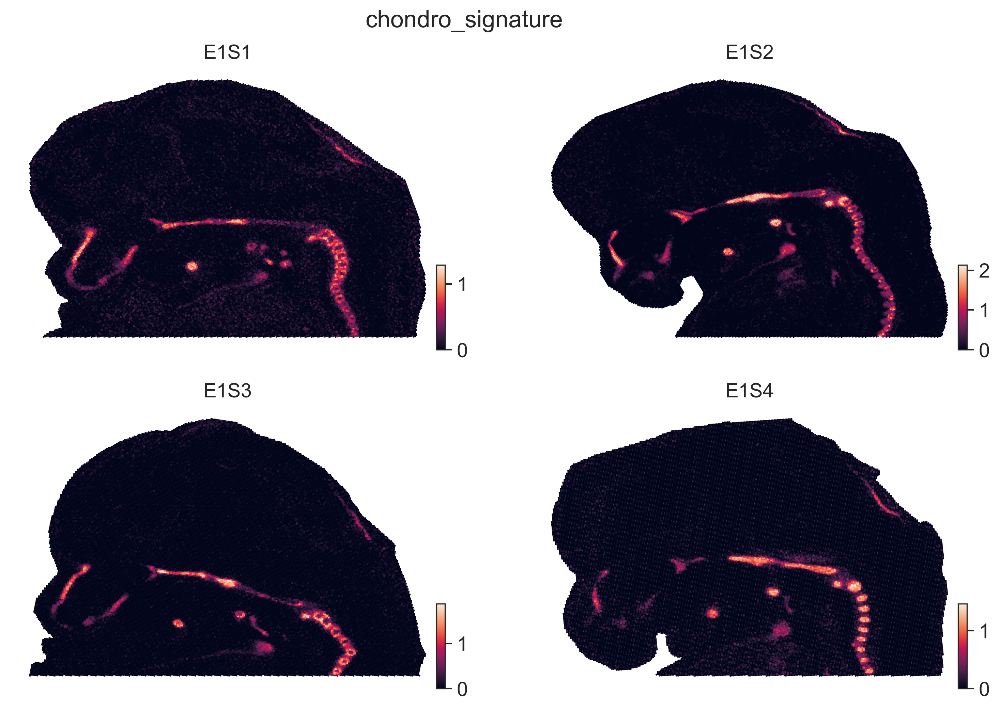

In [874]:
signature_panel(adatas, "chondro_signature", vmin=0)

In [ ]:
signatures = {}
for group in set(adata_subset.obs.clones_clusters_2):
    min_logfc = 1.5
    max_fdr = 0.01
    n_genes = 20

    df = sc.get.rank_genes_groups_df(adata_subset, group=group)
    signatures[group] = list(df[(df.logfoldchanges > min_logfc) & (df.pvals_adj < max_fdr)].head(n_genes).names)
    calculate_signature(adatas, signatures[group], f"{group}_signature")
    combine_signatures(adatas, "chondro_signature", f"{group}_signature", f"combined_{group}_signature", method=lambda x, y: x * y)
    
    signature_panel(adatas, f"combined_{group}_signature", vmin=0)

In [ ]:
adata_subset2 = adata_subset[adata_subset.obs.clones_clusters_2.isin(["0", "5", "14"])]
sc.tl.rank_genes_groups(adata_subset2, groupby="clones_clusters_2")

for group in ["0", "5", "14"]:
    min_logfc = 1.5
    max_fdr = 2
    n_genes = 10

    df = sc.get.rank_genes_groups_df(adata_subset2, group=group)
    signatures_new[group] = list(df[(df.logfoldchanges > min_logfc) & (df.pvals_adj < max_fdr)].head(n_genes).names)
    
    calculate_signature(adatas, signatures_new[group], f"{group}_signature_new")
    combine_signatures(adatas, "chondro_signature", f"{group}_signature_new", f"combined_{group}_signature_new")
    
    signature_panel(adatas, f"{group}_signature_new", vmin=0)

In [1013]:
adata_clones_head_expr = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/E13_face_clonal_embedding_expr.h5ad")
adata_clones_head_expr.obs["leiden_1_new"] = [
    "2+4" if i in ["4", "2"] else i for i in
    adata_clones_head_expr.obs["leiden_1"]
]
sc.tl.rank_genes_groups(adata_clones_head_expr, groupby="leiden_1_new", method="t-test")

In [1262]:
print(f"""signature_{cluster} = ["{'", "'.join(signature)}"]""")
print(", ".join(signature))

signature_2+4 = ["Meis1", "Meis2", "Hoxa2", "Smoc2", "Fibin", "8430419K02Rik", "Hoxaas2", "Hoxb3os", "Gm15050", "Cd34"]
Meis1, Meis2, Hoxa2, Smoc2, Fibin, 8430419K02Rik, Hoxaas2, Hoxb3os, Gm15050, Cd34


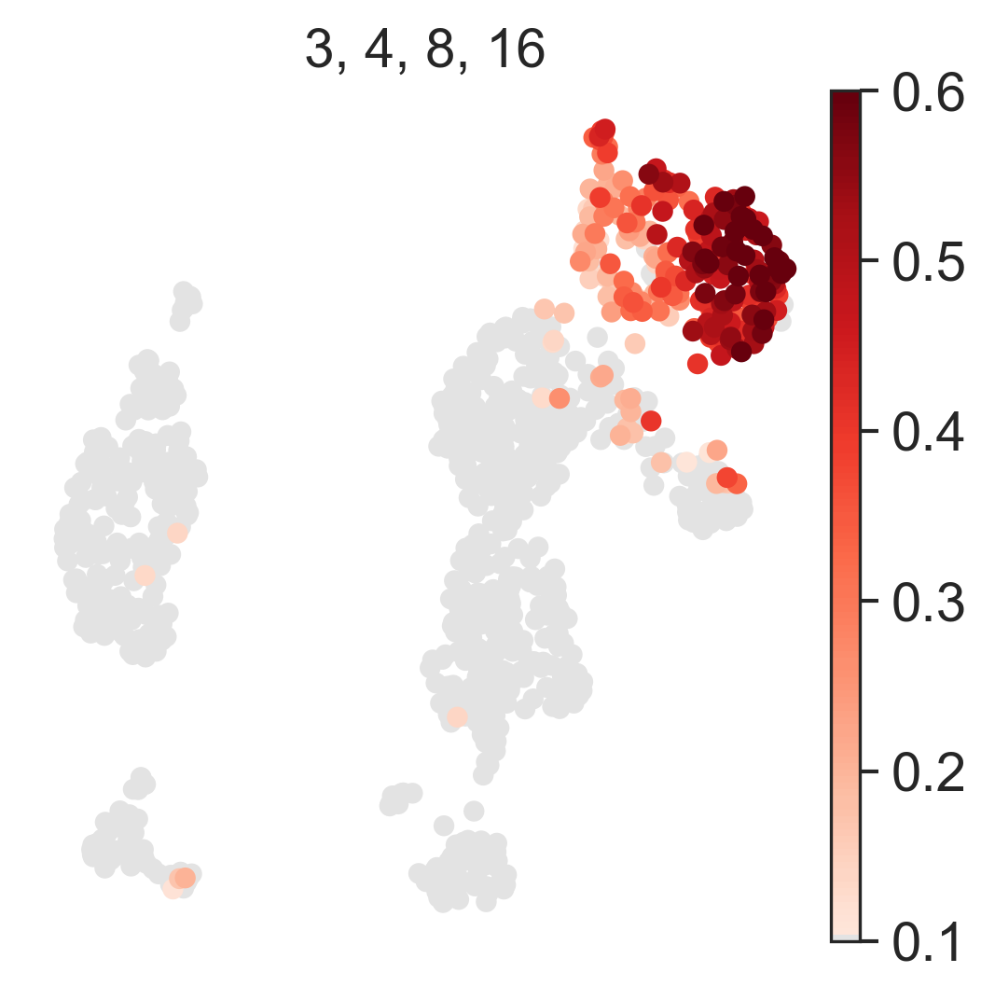

In [1263]:
sc.tl.score_genes(adata_clones_head_expr, gene_list=signature, score_name=f"{cluster} score")
sc.pl.umap(adata_clones_head_expr, color=f"{cluster} score", frameon=False, vmin=0.1,
           cmap=mb.pl.beautiful_cmap(), vmax=0.6, title="3, 4, 8, 16",
           save=f"{cluster}_clonal_embedding_signature.pdf")

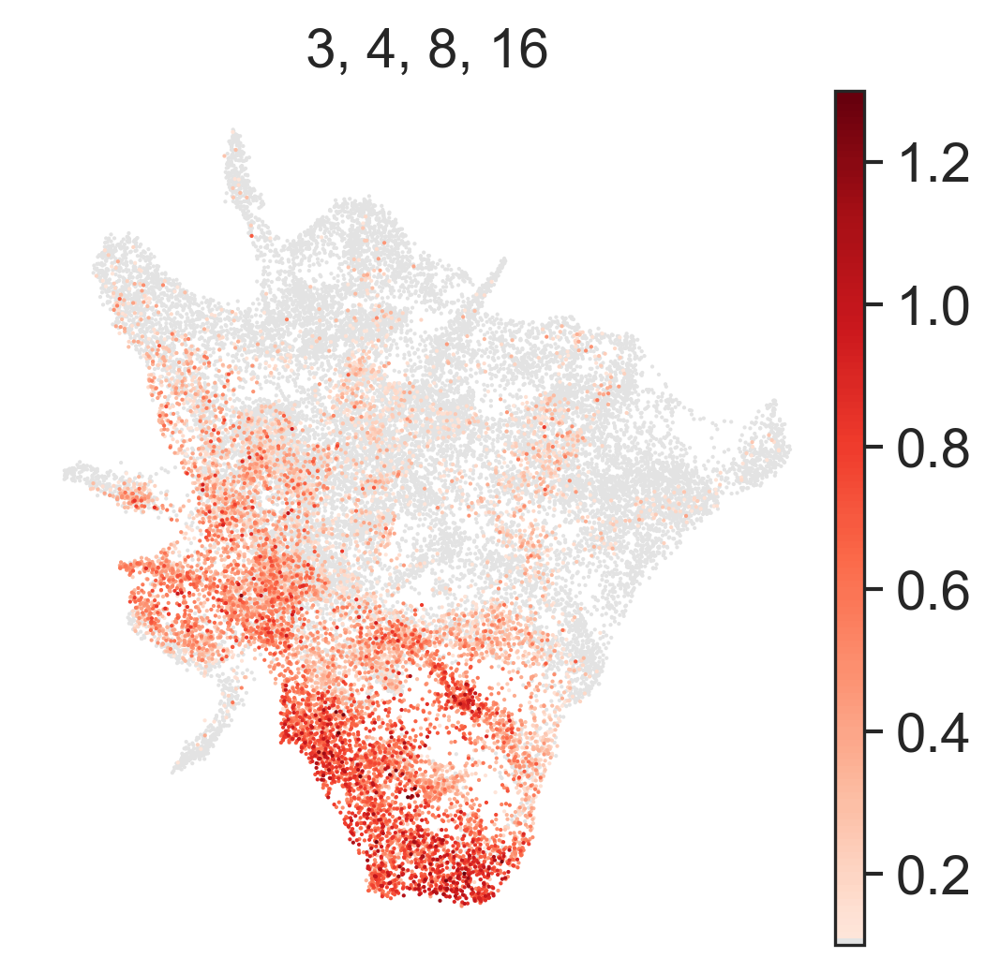

In [1244]:
sc.tl.score_genes(adata_face_mes, gene_list=signature, score_name=f"{cluster} score")
sc.pl.umap(adata_face_mes, color=f"{cluster} score", frameon=False, vmin=0.1,
           cmap=mb.pl.beautiful_cmap(), vmax=1.3, title="3, 4, 8, 16",
           save=f"{cluster}_gex_embedding_signature.pdf")

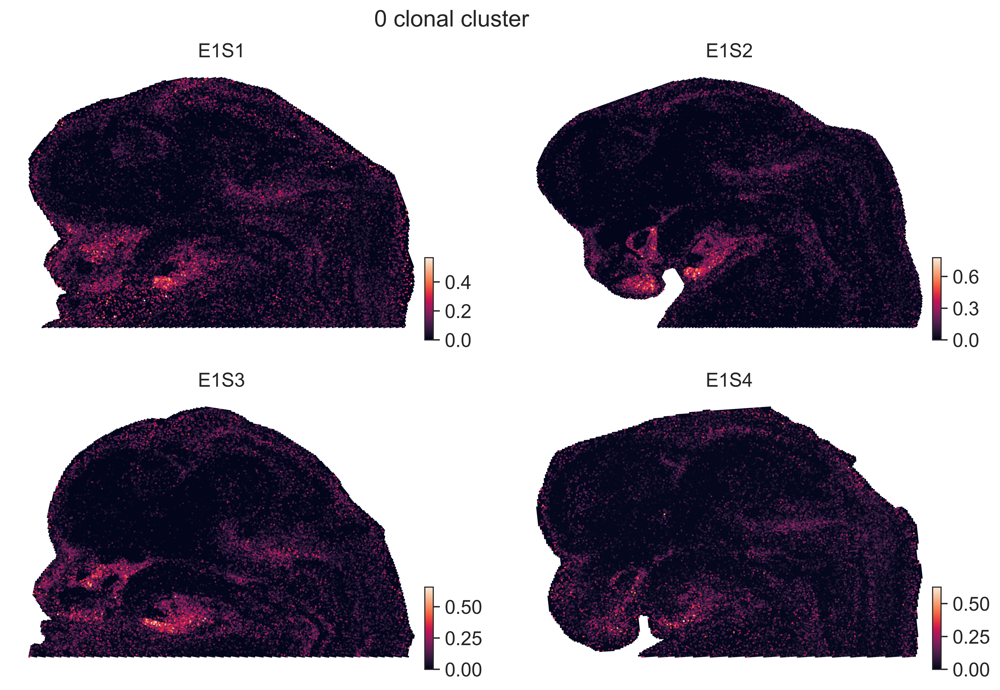

In [1265]:
cluster = "0"

min_logfc = 2
max_fdr = 0.01
n_genes = 10

df = sc.get.rank_genes_groups_df(adata_clones_head_expr, group=cluster)
signature = list(df[(df.logfoldchanges > min_logfc) & (df.pvals_adj < max_fdr)].names[:n_genes])

calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster", vmin=0)

plt.savefig("../figures/fig4/spatial_0.pdf", bbox_inches="tight")

In [1266]:
print(f"""signature_{cluster} = ["{'", "'.join(signature)}"]""")
print(", ".join(signature))

signature_0 = ["Prrx1", "Mab21l2", "Shox2", "Tbx3", "Hpgd", "Dkk1", "Kera", "Sp7", "Hoxd1", "Sox18"]
Prrx1, Mab21l2, Shox2, Tbx3, Hpgd, Dkk1, Kera, Sp7, Hoxd1, Sox18


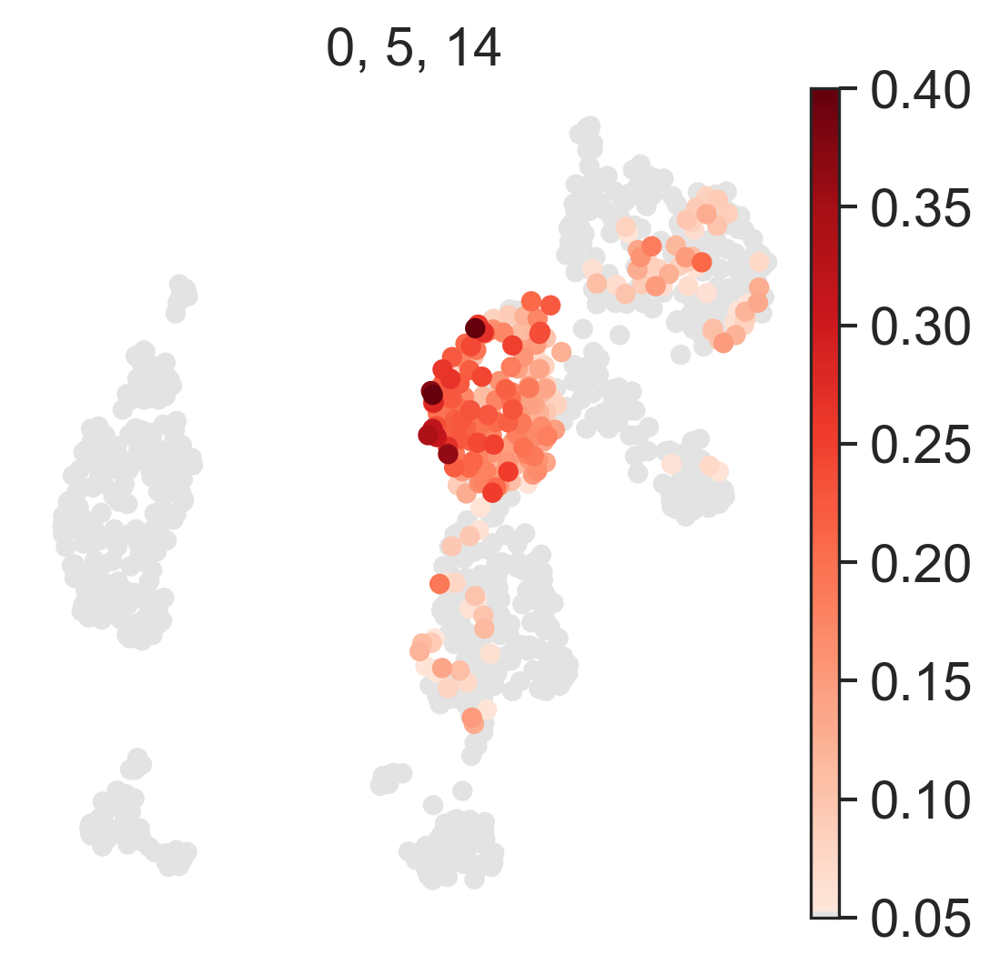

In [1228]:
sc.tl.score_genes(adata_clones_head_expr, gene_list=signature, score_name=f"{cluster} score")
sc.pl.umap(adata_clones_head_expr, color=f"{cluster} score", frameon=False, vmin=0.05,
           cmap=mb.pl.beautiful_cmap(), vmax=0.4, title="0, 5, 14",
           save=f"{cluster}_clonal_embedding_signature.pdf")

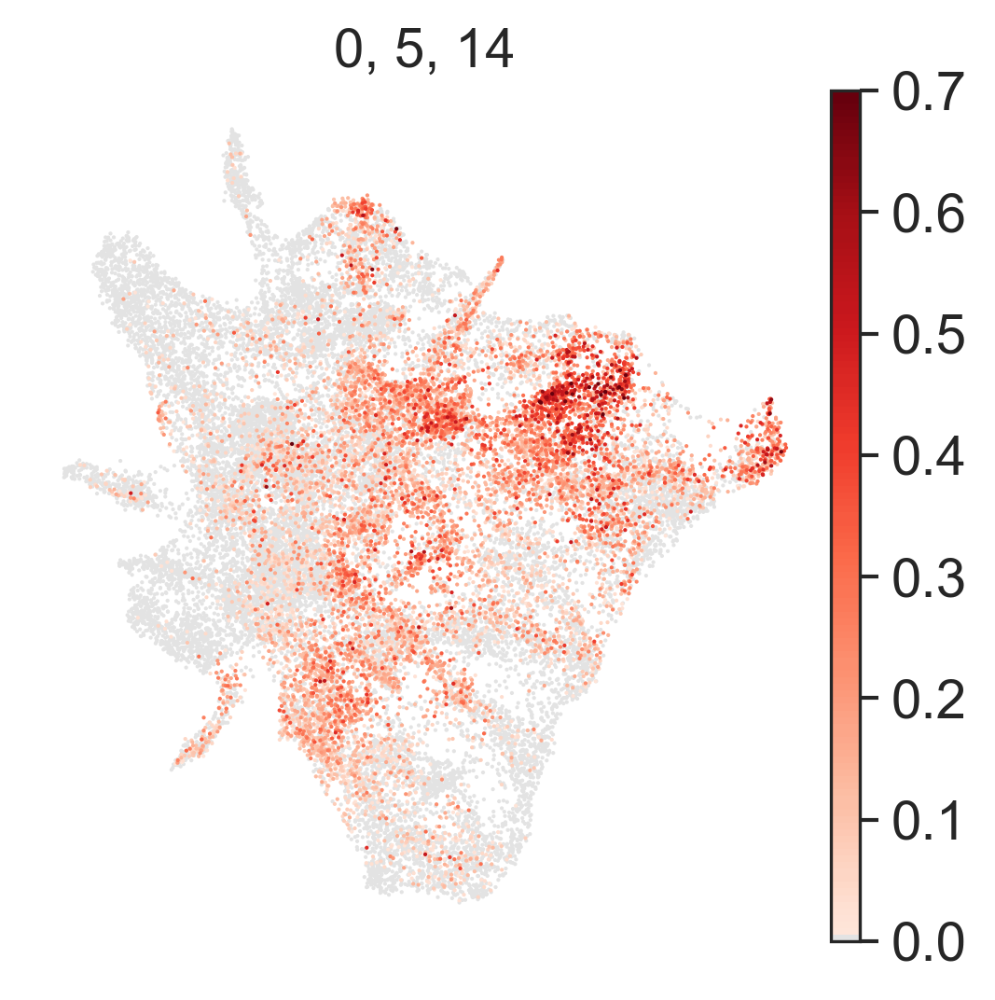

In [1249]:
sc.tl.score_genes(adata_face_mes, gene_list=signature, score_name=f"{cluster} score")
sc.pl.umap(adata_face_mes, color=f"{cluster} score", frameon=False, vmin=0,
           cmap=mb.pl.beautiful_cmap(), vmax=0.7, title="0, 5, 14",
           save=f"{cluster}_gex_embedding_signature.pdf")

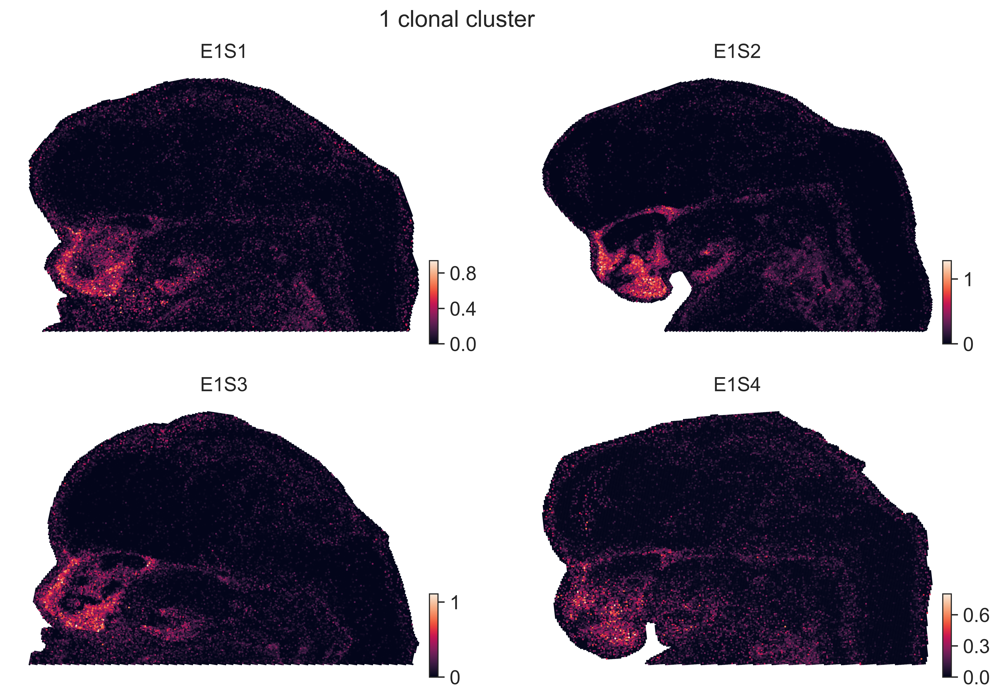

In [1267]:
cluster = "1"

min_logfc = 2
max_fdr = 0.01
n_genes = 10

df = sc.get.rank_genes_groups_df(adata_clones_head_expr, group=cluster)
signature = list(df[(df.logfoldchanges > min_logfc) & (df.pvals_adj < max_fdr)].names[:n_genes])

calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster", vmin=0)

plt.savefig("../figures/fig4/spatial_1.pdf", bbox_inches="tight")

In [1268]:
print(f"""signature_{cluster} = ["{'", "'.join(signature)}"]""")
print(", ".join(signature))

signature_1 = ["Hpse2", "Alx1", "Alx4", "Mgp", "Col8a1", "P4ha3", "Pax3", "Rgs6", "Gm34517", "Gata2"]
Hpse2, Alx1, Alx4, Mgp, Col8a1, P4ha3, Pax3, Rgs6, Gm34517, Gata2


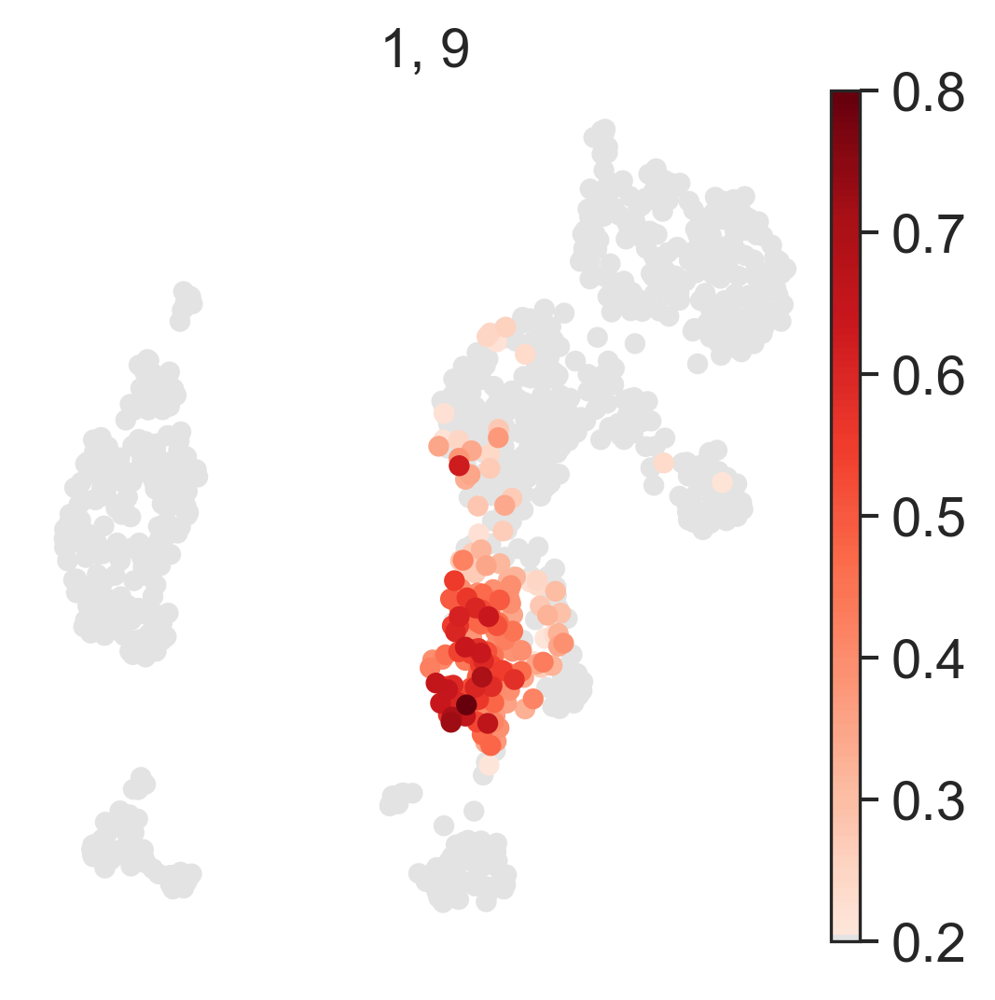

In [1239]:
sc.tl.score_genes(adata_clones_head_expr, gene_list=signature, score_name=f"{cluster} score")
sc.pl.umap(adata_clones_head_expr, color=f"{cluster} score", frameon=False, vmin=0.2,
           cmap=mb.pl.beautiful_cmap(), vmax=0.8, title="1, 9",
           save=f"{cluster}_clonal_embedding_signature.pdf")

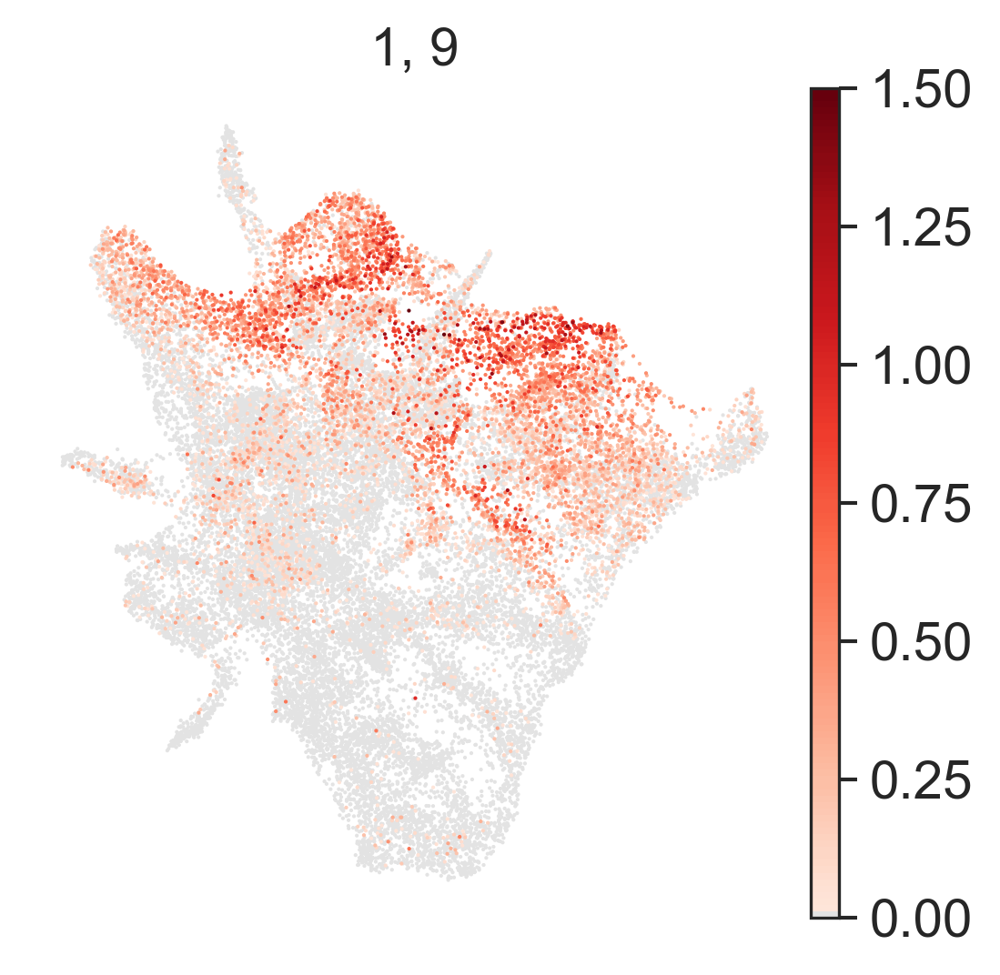

In [1253]:
sc.tl.score_genes(adata_face_mes, gene_list=signature, score_name=f"{cluster} score")
sc.pl.umap(adata_face_mes, color=f"{cluster} score", frameon=False, vmin=0,
           cmap=mb.pl.beautiful_cmap(), vmax=1.5, title="1, 9",
           save=f"{cluster}_gex_embedding_signature.pdf")

In [1103]:
adata_subset = adata_clones_head[adata_clones_head.obs.leiden_3 == "5"]
target_cells = adata_subset[adata_subset[:, "Glia"].X.T[0] > 1].obs_names

adata_clones_head.obs["target_cells"] = ["+" if bc in target_cells else "-" for bc in adata_clones_head.obs_names]
center = adata_clones_head[target_cells].obsm["word2vec"].mean(axis=0)
glia_center = adata_clones_head[adata_clones_head.obs.leiden_1 == "6"].obsm["word2vec"].mean(axis=0)

from sklearn.metrics.pairwise import cosine_similarity

adata_clones_head.obs["target_cells_cos"] = cosine_similarity(np.matrix(center), adata_clones_head.obsm["word2vec"])[0]
adata_clones_head.obs["glia_cos"] = cosine_similarity(np.matrix(glia_center), adata_clones_head.obsm["word2vec"])[0]

In [1111]:
mes_ct = list(set(adata_face[adata_face.obs.celltype_l0 == "Mesenchyme"].obs.celltype_l2))
NC_ct = ["Glia", "Melanocytes", "Sensory A", "Sympathetic", "Parasympathetic"]

In [1275]:
adata_subset = adata_clones_head[
    (adata_clones_head[:, mes_ct].X.sum(axis=1) > 0) &
    (adata_clones_head[:, NC_ct].X.sum(axis=1) > 0)
]
target_cc = adata_subset.obs.leiden_2.value_counts()[adata_subset.obs.leiden_2.value_counts() > 5].index
adata_subset = adata_subset[adata_subset.obs.leiden_2.isin(target_cc)]
adata_subset = adata_subset[:, adata_subset.X.sum(axis=0) > 0]

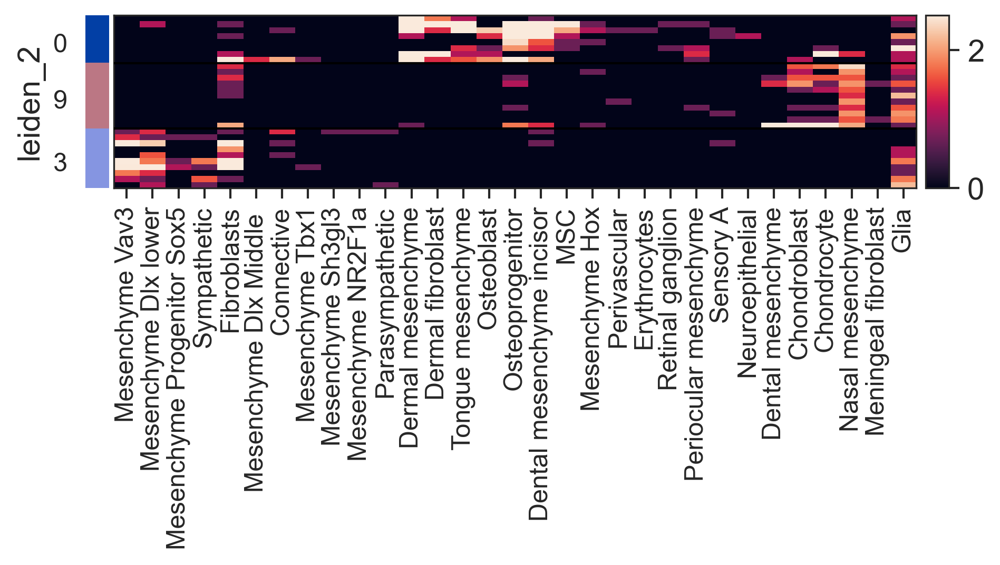

In [1276]:
adata_subset.layers["log"] = np.log1p(adata_subset.X)

from scipy.cluster.hierarchy import linkage, dendrogram

ct_order = dendrogram(linkage(adata_subset.layers["log"].T, method="average", metric="correlation"), no_plot=True)["leaves"][::-1]
ct_order = adata_subset.var_names[ct_order]

sc.pl.heatmap(adata_subset, groupby="leiden_2", var_names=ct_order, dendrogram=False, 
              figsize=(7, 1.5), layer="log", show_gene_labels=True, vmax=2.5, save="glia_face_heatmap.pdf")

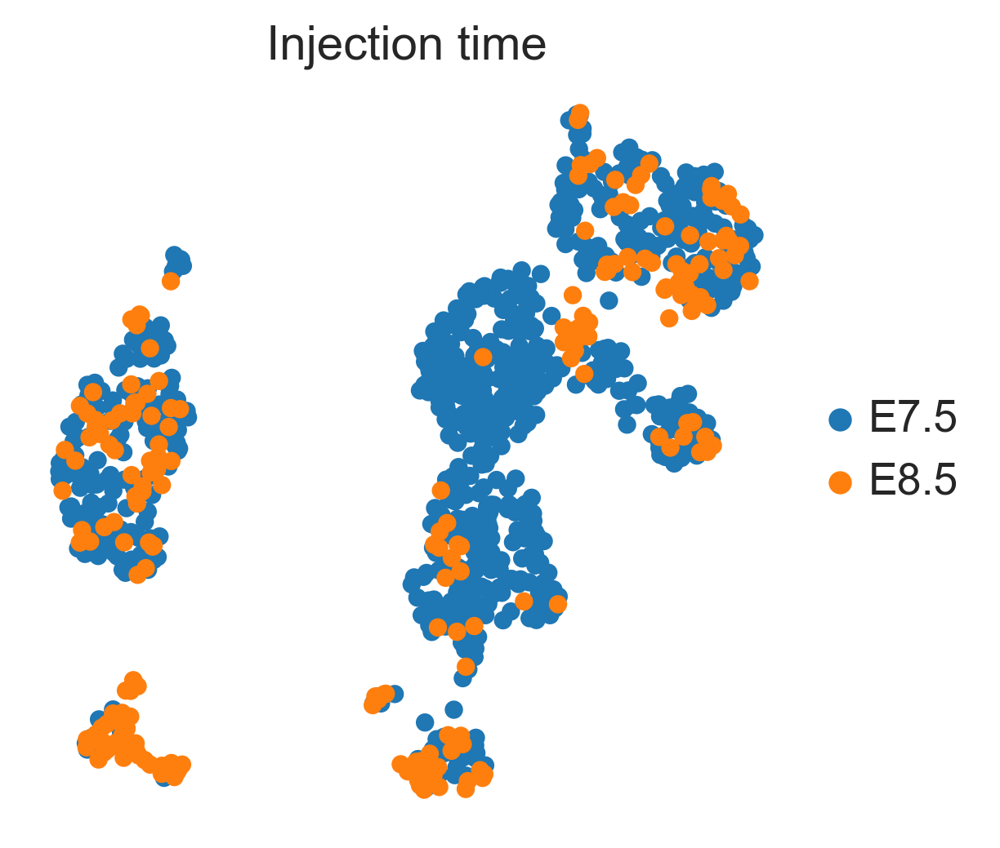

In [1279]:
sc.pl.umap(adata_clones_head, color="injection_time", frameon=False,
           title="Injection time", save="face_inj_time.pdf")

In [1191]:
adata_clones_head_ = adata_clones_head.copy()
sc.pp.log1p(adata_clones_head_)
sc.tl.score_genes(adata_clones_head_, gene_list=mes_ct, score_name="Mes_score")
sc.tl.score_genes(adata_clones_head_, gene_list=NC_ct, score_name="Glia_score")

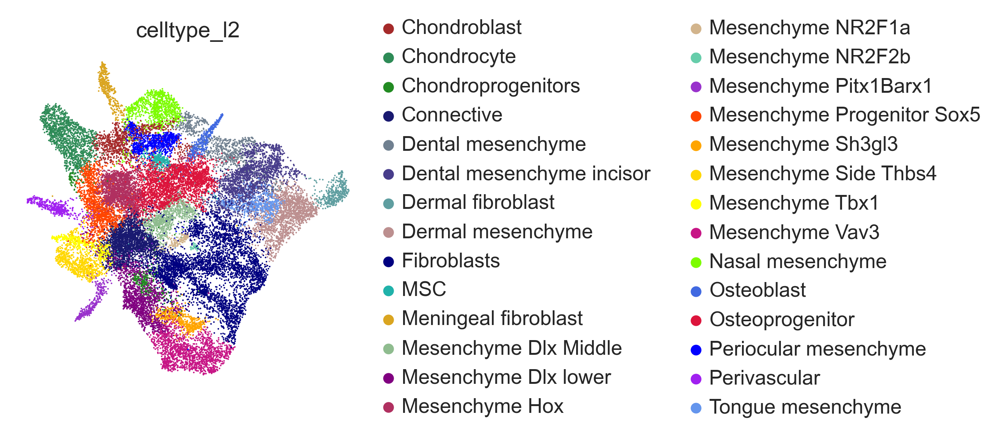

In [1205]:
sc.pl.umap(adata_face_mes, color="celltype_l2", frameon=False)

In [114]:
adata = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_E13_clonal_clusters.h5ad")
description = "Face (control)"

In [115]:
dist_E7 = adata.obs["E7.5:clones"].value_counts()[adata.obs["E7.5:clones"].value_counts() > 1][1:]
dist_E8 = adata.obs["E8.5:clones"].value_counts()[adata.obs["E8.5:clones"].value_counts() > 1][1:]

E7_labeled_cells = dist_E7.sum()
E7_clones = len(dist_E7)

E8_labeled_cells = dist_E8.sum()
E8_clones = len(dist_E8)

double_labeled = sum((adata.obs["E7.5:clones"].isin(dist_E7.index)) & (adata.obs["E8.5:clones"].isin(dist_E8.index)))
total_cells = len(adata)

double_injected = adata[(adata.obs["E7.5:clones"].isin(dist_E7.index)) & (adata.obs["E8.5:clones"].isin(dist_E8.index))]
double_injected = double_injected.obs[["E7.5:clones", "E8.5:clones"]].groupby(["E7.5:clones", "E8.5:clones"]).size().unstack()

consistency = np.mean(double_injected.max(axis=0) / double_injected.sum(axis=0))

print(description + "\n")

print(f"Total cells:\t{total_cells}\n")

print(f"Number of cells in E7 cells in informative (> 2 cells) clones:\t{E7_labeled_cells} ({E7_labeled_cells / total_cells * 100:.2f}%)")
print(f"Number of E7 informative (> 2 cells) clones:\t{E7_clones}\n")

print(f"Number of cells in E8 cells in informative (> 2 cells) clones:\t{E8_labeled_cells} ({E8_labeled_cells / total_cells * 100:.2f}%)")
print(f"Number of E8 informative (> 2 cells) clones:\t{E8_clones}\n")

print(f"Number of cells in both E7 and E8 informative clones:\t{double_labeled} ({double_labeled / total_cells * 100:.2f}%)")
print(f"Number of cells in any informative clones (E7 + E8 - E7E8):\t{E7_labeled_cells + E8_labeled_cells - double_labeled} ({(E7_labeled_cells + E8_labeled_cells - double_labeled) / total_cells * 100:.2f}%)\n")

print(f"Consistency score (for double barcoded cells: mean fraction of E8 clone inside the biggest E7 parental clone):\t{consistency}")

Face (control)

Total cells:	50457

Number of cells in E7 cells in informative (> 2 cells) clones:	22693 (44.97%)
Number of E7 informative (> 2 cells) clones:	1437

Number of cells in E8 cells in informative (> 2 cells) clones:	5239 (10.38%)
Number of E8 informative (> 2 cells) clones:	1149

Number of cells in both E7 and E8 informative clones:	284 (0.56%)
Number of cells in any informative clones (E7 + E8 - E7E8):	27648 (54.80%)

Consistency score (for double barcoded cells: mean fraction of E8 clone inside the biggest E7 parental clone):	0.9615267711012391


In [ ]:
files = !ls /home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_*_E13*
files = [i for i in files if "NC" not in i]

for file in files:
    name = file.split("merged_clones_trunk_E13/")[1].split("_E13")[0]
    adata = sc.read_h5ad(file)
    adata.uns["log1p"]["base"] = None
    sc.tl.rank_genes_groups(adata, groupby="celltype_l2", method="t-test")
    sc.tl.dendrogram(adata, groupby="celltype_l2", use_rep="X_pca_harmony")
    sc.pl.rank_genes_groups_dotplot(
        adata,
        n_genes=5,
        groupby="celltype_l2",
        standard_scale="var",
        dendrogram=True,
        min_logfoldchange=2,
        save=f"{name}.pdf",
    )

In [ ]:
files = !ls /home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_*_E13*
files = [i for i in files if "glia" not in i]

for file in files:
    name = file.split("merged_clones_face_E13/")[1].split("_E13")[0]
    adata = sc.read_h5ad(file)
    adata.uns["log1p"]["base"] = None
    sc.tl.rank_genes_groups(adata, groupby="celltype_l2", method="t-test")
    sc.tl.dendrogram(adata, groupby="celltype_l2", use_rep="X_pca_harmony")
    sc.pl.rank_genes_groups_dotplot(
        adata,
        n_genes=5,
        groupby="celltype_l2",
        standard_scale="var",
        dendrogram=True,
        min_logfoldchange=2,
        save=f"{name}.pdf",
    )